<img src="http://imgur.com/1ZcRyrc.png" style="float: left; margin: 20px; height: 55px">

# Project 4: West Nile Virus Prediction
# Notebook 6 - Cost Benefit Analysis Part 1

In [1]:
# import libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
pd.options.display.max_rows = 999
import datetime
import matplotlib.image as mpimg

MAPBOX_TOKEN = 'pk.eyJ1IjoiZGVlcG1hcmF1ZGVyIiwiYSI6ImNsOWdyc2NycTN5dmozdnFtb2NzOWJuMjcifQ.qBy4LTu26bsUjRYWCaWZQw'

In [2]:
# import spray dataset
spray = pd.read_csv('../assets/spray_cleaned.csv',usecols=['date','lat','long'])
spray['type'] = 'spray'
print(spray.shape)
spray.head()

(13710, 4)


,date,lat,long,type
0,2011-08-29,42.391623,-88.089163,spray
1,2011-08-29,42.391348,-88.089163,spray
2,2011-08-29,42.391022,-88.089157,spray
3,2011-08-29,42.390637,-88.089158,spray
4,2011-08-29,42.390410,-88.088858,spray


In [3]:
trap = pd.read_csv('../assets/train.csv',usecols=['Date','Latitude','Longitude','NumMosquitos','WnvPresent'])
trap.columns=['date','lat','long','nummosquitos','wnvpresent']
trap['type'] = 'trap'
print(trap.shape)
trap.head()

(10506, 6)


,date,lat,long,nummosquitos,wnvpresent,type
0,2007-05-29,41.954690,-87.800991,1,0,trap
1,2007-05-29,41.954690,-87.800991,1,0,trap
2,2007-05-29,41.994991,-87.769279,1,0,trap
3,2007-05-29,41.974089,-87.824812,1,0,trap
4,2007-05-29,41.974089,-87.824812,4,0,trap


# Merge datasets

In [4]:
# merge spray and trap dataframes to form overall dataframe
merged = pd.concat([spray,trap])
print(merged.shape)
merged.head()

(24216, 6)


,date,lat,long,type,nummosquitos,wnvpresent
0,2011-08-29,42.391623,-88.089163,spray,NaN,NaN
1,2011-08-29,42.391348,-88.089163,spray,NaN,NaN
2,2011-08-29,42.391022,-88.089157,spray,NaN,NaN
3,2011-08-29,42.390637,-88.089158,spray,NaN,NaN
4,2011-08-29,42.390410,-88.088858,spray,NaN,NaN


In [5]:
# dates when sprays were carried out
np.unique(merged[merged.type=='spray'].date)

array(['2011-08-29', '2011-09-07', '2013-07-17', '2013-07-25',
       '2013-08-08', '2013-08-15', '2013-08-16', '2013-08-22',
       '2013-08-29', '2013-09-05'], dtype=object)

In [6]:
# fill NaNs in spray rows with zeros
merged = merged.fillna(0)

# Locations of sprays, traps with mosquitoes and traps where WNV is present


In [7]:
merged

,date,lat,long,type,nummosquitos,wnvpresent
0,2011-08-29,42.391623,-88.089163,spray,0.0,0.0
1,2011-08-29,42.391348,-88.089163,spray,0.0,0.0
2,2011-08-29,42.391022,-88.089157,spray,0.0,0.0
3,2011-08-29,42.390637,-88.089158,spray,0.0,0.0
4,2011-08-29,42.390410,-88.088858,spray,0.0,0.0
...,...,...,...,...,...,...
10501,2013-09-26,41.763733,-87.742302,trap,6.0,1.0
10502,2013-09-26,41.987280,-87.666066,trap,5.0,0.0
10503,2013-09-26,41.912563,-87.668055,trap,1.0,0.0
10504,2013-09-26,42.009876,-87.807277,trap,5.0,0.0


In [8]:
# create dataframe with 'trap with WMV' as a type in order to overlay on map plot

merged_wmv_traps = merged.loc[(merged.type=='trap') & (merged.wnvpresent==1)].replace('trap','trap with WMV')
merged_wmv_traps

,date,lat,long,type,nummosquitos,wnvpresent
553,2007-07-18,41.686398,-87.531635,trap with WMV,50.0,1.0
603,2007-07-25,41.673408,-87.599862,trap with WMV,50.0,1.0
611,2007-07-25,41.673408,-87.599862,trap with WMV,50.0,1.0
618,2007-07-25,41.673408,-87.599862,trap with WMV,50.0,1.0
660,2007-07-25,41.673408,-87.599862,trap with WMV,50.0,1.0
661,2007-07-25,41.673408,-87.599862,trap with WMV,50.0,1.0
777,2007-08-01,41.954690,-87.800991,trap with WMV,50.0,1.0
778,2007-08-01,41.954690,-87.800991,trap with WMV,21.0,1.0
784,2007-08-01,41.974089,-87.824812,trap with WMV,5.0,1.0
812,2007-08-01,41.688324,-87.676709,trap with WMV,33.0,1.0


In [9]:
count = merged[merged.type=='trap'][['lat','long']].drop_duplicates().shape[0]
print("Unique multiple columns : "+ str(count))

Unique multiple columns : 138


In [10]:
count = merged_wmv_traps[['lat','long']].drop_duplicates().shape[0]
print("Unique multiple columns : "+ str(count))

Unique multiple columns : 99


During the period between 2007 to 2013, there were **138** unique locations where traps were laid and mosquitoes were caught. Among these locations, **99** of them had reported the presence of the West Nile virus at some point in time.

In [11]:
# dates sprays were carried out on
print(merged[merged.type=='spray'].date.unique())
print('\n')

# first and last dates of sprays
spray_first_date = merged[merged.type=='spray'].date.unique().min()
print(f'First day the spray was carried out on: {spray_first_date}')

spray_last_date = merged[merged.type=='spray'].date.unique().max()
print(f'Last day the spray was carried out on: {spray_last_date}')

['2011-08-29' '2011-09-07' '2013-07-17' '2013-07-25' '2013-08-08'
 '2013-08-15' '2013-08-16' '2013-08-22' '2013-08-29' '2013-09-05']


First day the spray was carried out on: 2011-08-29
Last day the spray was carried out on: 2013-09-05


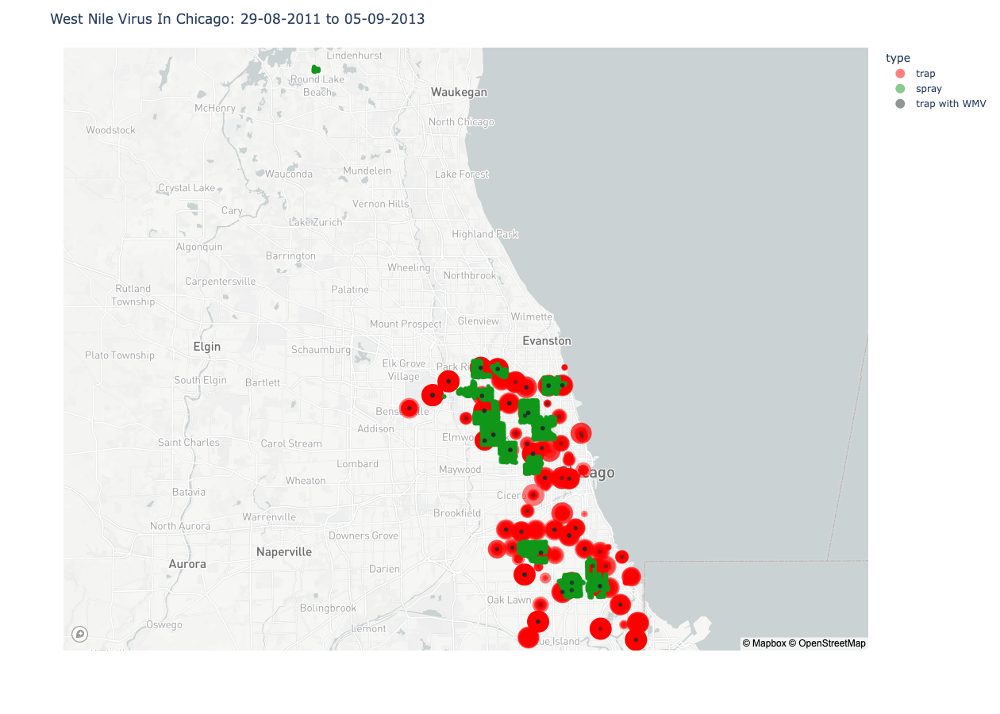

In [12]:
px.set_mapbox_access_token(MAPBOX_TOKEN)


fig = px.scatter_mapbox(merged[(merged.type=='trap') & (merged.date >= spray_first_date) & (merged.date <= spray_last_date)],
                        lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                        size='nummosquitos',
                        color_discrete_sequence=['red'],
                        opacity = 0.5,
                       zoom = 9) # size_max=15, 

fig2 = px.scatter_mapbox(merged[(merged.type=='spray')], lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                         color_discrete_sequence=['#109618'],
                        size_max=1, 
                         opacity=0.5,
                         zoom = 9)

fig3 = px.scatter_mapbox(merged_wmv_traps[(merged_wmv_traps.date >= spray_first_date) & (merged_wmv_traps.date <= spray_last_date)],
                         lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                         color_discrete_sequence=['#222A2A'],
                        size_max=1, 
                         opacity=0.5,
                         zoom =9)

fig.add_trace(fig2.data[0])
fig.add_trace(fig3.data[0])

fig.update_layout(title = 'West Nile Virus In Chicago: 29-08-2011 to 05-09-2013',
                  mapbox_center={"lat": 42.034, "lon": -87.833}, # center map to a particular point
                  autosize=True,
                  width=900,
                  height=900,)

fig.show()
fig.write_image("../images/spray_start_end_all.jpeg")

The map above provides the locations where mosquitoes traps were laid (red) and where subsequently the presence of the West Nile virus was detected (black) during the period between 2011-08-29 and 2013-09-05 when the sprays (green) were first and last carried based on the spray dataset. Overall, the presence of a large number of mosquito traps, the detection of the West Nile virus and the lack of spraying coverage in the bottom half of the affected areas suggests the spraying of pesticides was not as effective as it could have been.

# Effectiveness of sprays
We will take a closer look at the effectiveness of the sprays carried out on each occasion by oberving the affected areas 2 weeks before and 2 weeks after the date of insecticide spraying. 

In [13]:
merged['date_datetime'] = pd.to_datetime(merged['date'],
                           format = '%Y-%m-%d')

merged_wmv_traps['date_datetime'] = pd.to_datetime(merged_wmv_traps['date'],
                           format = '%Y-%m-%d')

# 1. Insecticide spray on 29-08-2011

## 1.1. 2 Weeks before 29-08-2011

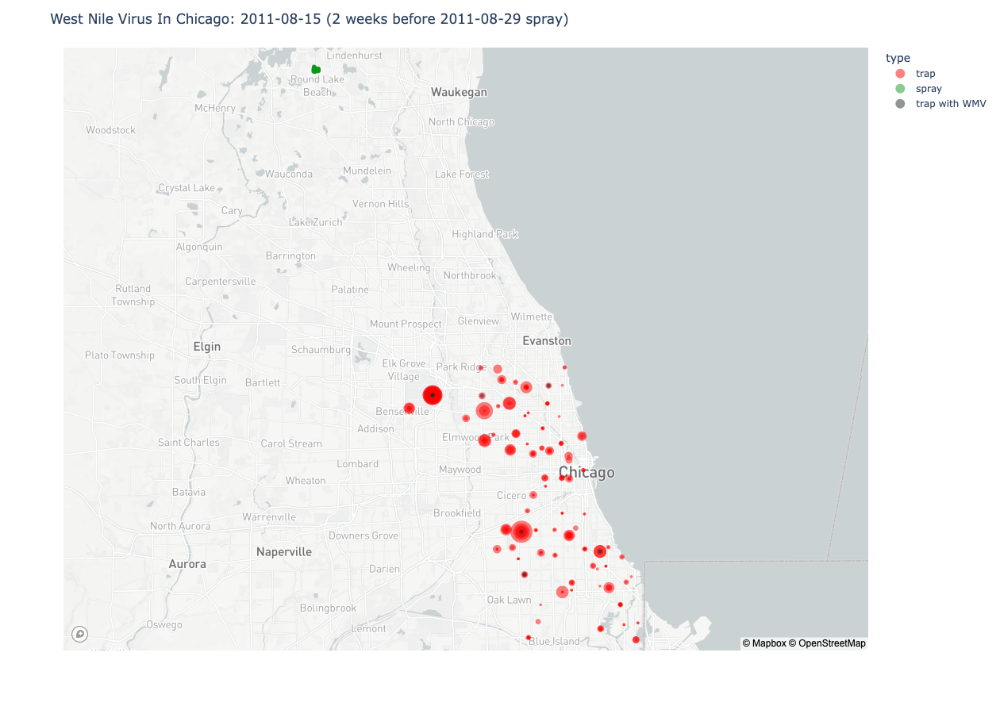

In [14]:
spray_date = pd.Timestamp(2011, 8, 29)

period_before = (spray_date - datetime.timedelta(weeks=2))
period_after= (spray_date + datetime.timedelta(weeks=2))





px.set_mapbox_access_token(MAPBOX_TOKEN)


fig = px.scatter_mapbox(merged[(merged.type=='trap') & (merged['date_datetime'] >= period_before) & (merged['date_datetime'] < spray_date)],
                        lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                        size='nummosquitos',
                        color_discrete_sequence=['red'],
                        opacity = 0.5,
                       zoom = 9) # size_max=15, 

fig2 = px.scatter_mapbox(merged[(merged.type=='spray') & (merged.date_datetime == spray_date)], lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                         color_discrete_sequence=['#109618'],
                        size_max=1, 
                         opacity=0.5,
                         zoom = 9)

fig3 = px.scatter_mapbox(merged_wmv_traps[(merged_wmv_traps.date_datetime >= period_before) & (merged_wmv_traps.date_datetime < spray_date)],
                         lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                         color_discrete_sequence=['#222A2A'],
                        size_max=1, 
                         opacity=0.5,
                         zoom =9)

fig.add_trace(fig2.data[0])
fig.add_trace(fig3.data[0])

image_date = merged[(merged.date_datetime == spray_date)].date[0]
period_before = period_before.date()

fig.update_layout(title = f'West Nile Virus In Chicago: {period_before} (2 weeks before {image_date} spray)',
                  mapbox_center={"lat": 42.034, "lon": -87.833}, # center map to a particular point
                  autosize=True,
                  width=900,
                  height=900,)

fig.show()
fig.write_image(f'../images/spray_before_{image_date}.png')

## 1.2. 2 Weeks After 29-08-2011

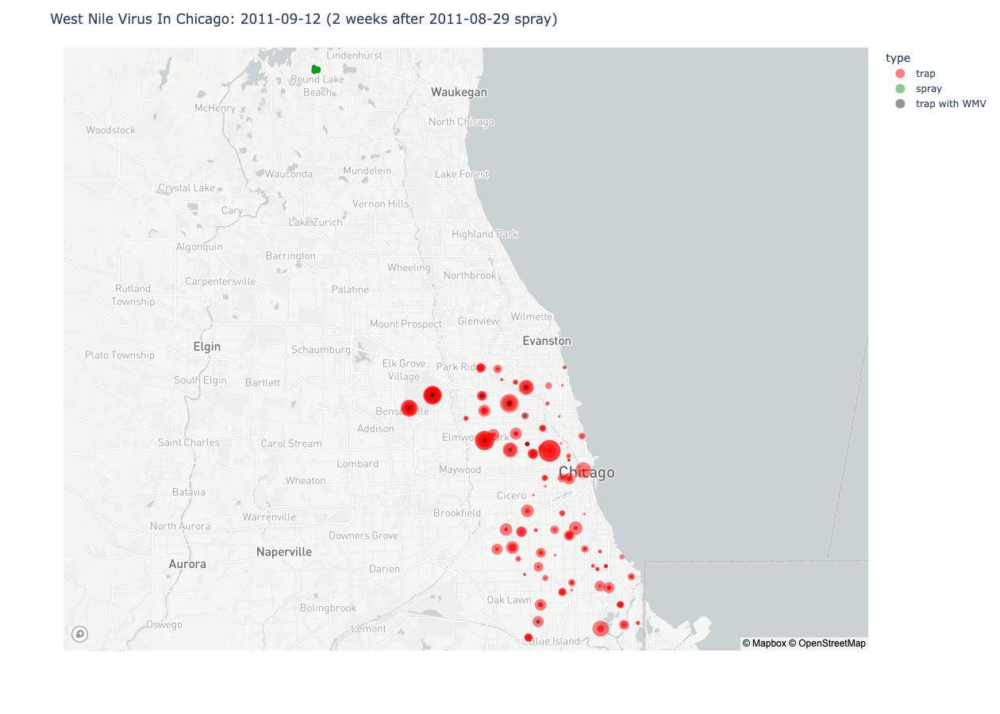

In [15]:
spray_date = pd.Timestamp(2011, 8, 29)

period_before = (spray_date - datetime.timedelta(weeks=2))
period_after= (spray_date + datetime.timedelta(weeks=2))





px.set_mapbox_access_token(MAPBOX_TOKEN)


fig = px.scatter_mapbox(merged[(merged.type=='trap') & (merged['date_datetime'] >= spray_date) & (merged['date_datetime'] <= period_after)],
                        lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                        size='nummosquitos',
                        color_discrete_sequence=['red'],
                        opacity = 0.5,
                       zoom = 9) # size_max=15, 

fig2 = px.scatter_mapbox(merged[(merged.type=='spray') & (merged.date_datetime == spray_date)], lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                         color_discrete_sequence=['#109618'],
                        size_max=1, 
                         opacity=0.5,
                         zoom = 9)

fig3 = px.scatter_mapbox(merged_wmv_traps[(merged_wmv_traps.date_datetime >= spray_date) & (merged_wmv_traps.date_datetime <= period_after)],
                         lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                         color_discrete_sequence=['#222A2A'],
                        size_max=1, 
                         opacity=0.5,
                         zoom =9)

fig.add_trace(fig2.data[0])
fig.add_trace(fig3.data[0])

image_date = merged[(merged.date_datetime == spray_date)].date[0]
period_after = period_after.date()

fig.update_layout(title = f'West Nile Virus In Chicago: {period_after} (2 weeks after {image_date} spray)',
                  mapbox_center={"lat": 42.034, "lon": -87.833}, # center map to a particular point
                  autosize=True,
                  width=900,
                  height=900,)

fig.show()
fig.write_image(f'../images/spray_after_{image_date}.png')

## 1.3. Side by side comparison of affected areas before and after 29-08-2011

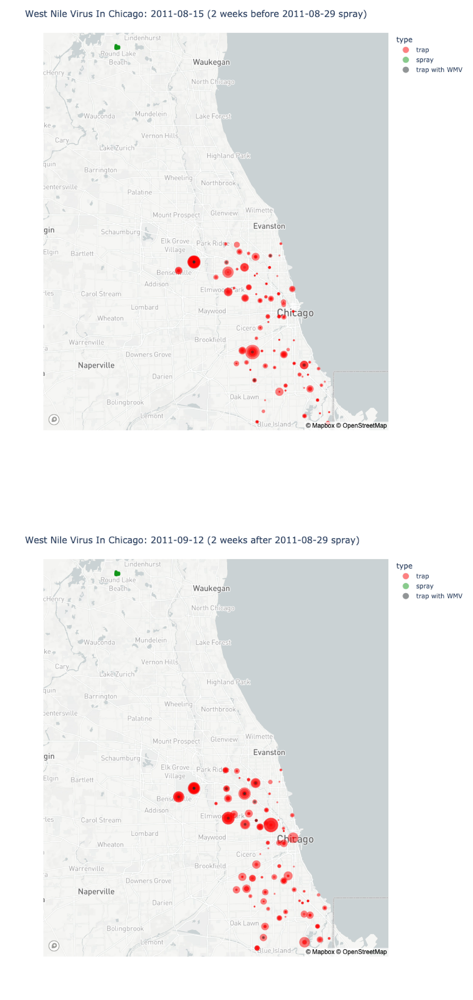

In [16]:
fig = plt.figure()

ax1 = fig.add_subplot(2,1,1)
ax2 = fig.add_subplot(2,1,2)

img1 = mpimg.imread(f'../images/spray_before_{image_date}.png')
ax1.imshow(img1)
ax1.axis('off')

img2 = mpimg.imread(f'../images/spray_after_{image_date}.png')
ax2.imshow(img2)
ax2.axis('off')

plt.subplots_adjust(wspace=0, hspace=0)
fig.set_figheight(90)
fig.set_figwidth(40)

# 2. Insecticide spray on 07-09-2011

## 2.1. 2 Weeks before 07-09-2011

In [17]:
merged[(merged.date_datetime == spray_date)].date.iloc[0]

'2011-08-29'

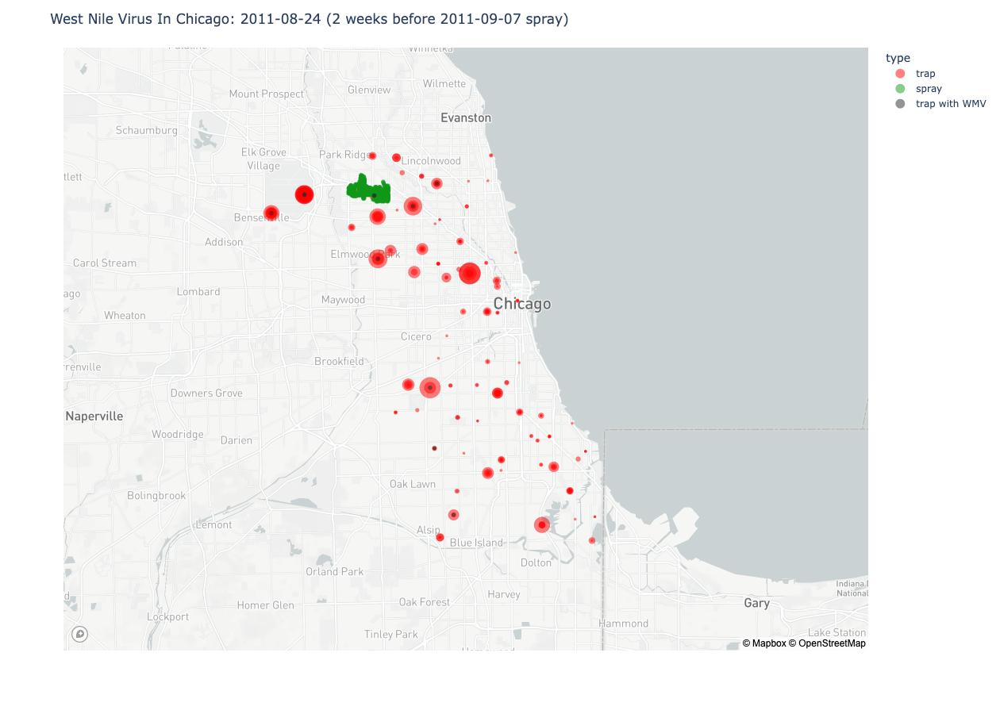

In [18]:
spray_date = pd.Timestamp(2011, 9, 7)

period_before = (spray_date - datetime.timedelta(weeks=2))
period_after= (spray_date + datetime.timedelta(weeks=2))





px.set_mapbox_access_token(MAPBOX_TOKEN)


fig = px.scatter_mapbox(merged[(merged.type=='trap') & (merged['date_datetime'] >= period_before) & (merged['date_datetime'] < spray_date)],
                        lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                        size='nummosquitos',
                        color_discrete_sequence=['red'],
                        opacity = 0.5,
                       zoom = 9.5) # size_max=15, 

fig2 = px.scatter_mapbox(merged[(merged.type=='spray') & (merged.date_datetime == spray_date)], lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                         color_discrete_sequence=['#109618'],
                        size_max=1, 
                         opacity=0.5,
                         zoom = 9.5)

fig3 = px.scatter_mapbox(merged_wmv_traps[(merged_wmv_traps.date_datetime >= period_before) & (merged_wmv_traps.date_datetime < spray_date)],
                         lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                         color_discrete_sequence=['#222A2A'],
                        size_max=1, 
                         opacity=0.5,
                         zoom =9.5)

fig.add_trace(fig2.data[0])
fig.add_trace(fig3.data[0])

image_date = merged[(merged.date_datetime == spray_date)].date.iloc[0]
period_before = period_before.date()

fig.update_layout(title = f'West Nile Virus In Chicago: {period_before} (2 weeks before {image_date} spray)',
                  mapbox_center={"lat": 41.834, "lon": -87.693}, # center map to a particular point
                  autosize=True,
                  width=900,
                  height=900,)

fig.show()
fig.write_image(f'../images/spray_before_{image_date}.png')

## 2.2. 2 Weeks After 07-09-2011

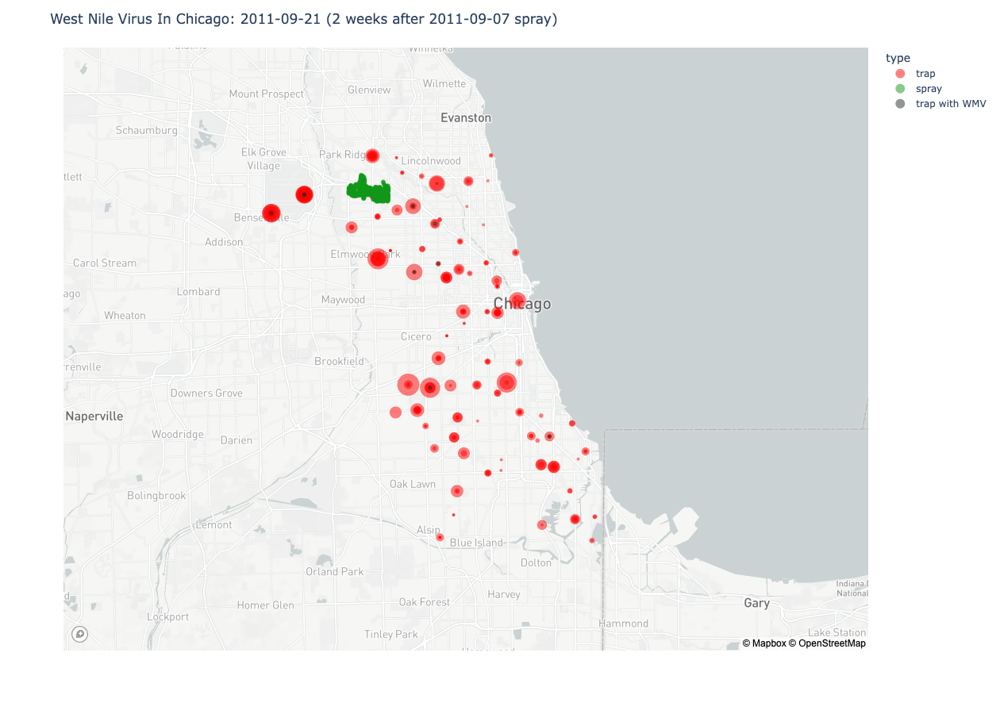

In [19]:
spray_date = pd.Timestamp(2011, 9, 7)

period_before = (spray_date - datetime.timedelta(weeks=2))
period_after= (spray_date + datetime.timedelta(weeks=2))





px.set_mapbox_access_token(MAPBOX_TOKEN)


fig = px.scatter_mapbox(merged[(merged.type=='trap') & (merged['date_datetime'] >= spray_date) & (merged['date_datetime'] <= period_after)],
                        lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                        size='nummosquitos',
                        color_discrete_sequence=['red'],
                        opacity = 0.5,
                       zoom = 9.5) # size_max=15, 

fig2 = px.scatter_mapbox(merged[(merged.type=='spray') & (merged.date_datetime == spray_date)], lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                         color_discrete_sequence=['#109618'],
                        size_max=1, 
                         opacity=0.5,
                         zoom = 9.5)

fig3 = px.scatter_mapbox(merged_wmv_traps[(merged_wmv_traps.date_datetime >= spray_date) & (merged_wmv_traps.date_datetime <= period_after)],
                         lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                         color_discrete_sequence=['#222A2A'],
                        size_max=1, 
                         opacity=0.5,
                         zoom =9.5)

fig.add_trace(fig2.data[0])
fig.add_trace(fig3.data[0])

image_date = merged[(merged.date_datetime == spray_date)].date.iloc[0]
period_after = period_after.date()

fig.update_layout(title = f'West Nile Virus In Chicago: {period_after} (2 weeks after {image_date} spray)',
                  mapbox_center={"lat": 41.834, "lon": -87.693}, # center map to a particular point
                  autosize=True,
                  width=900,
                  height=900,)

fig.show()
fig.write_image(f'../images/spray_after_{image_date}.png')

## 2.3. Side by side comparison of affected areas before and after 07-09-2011

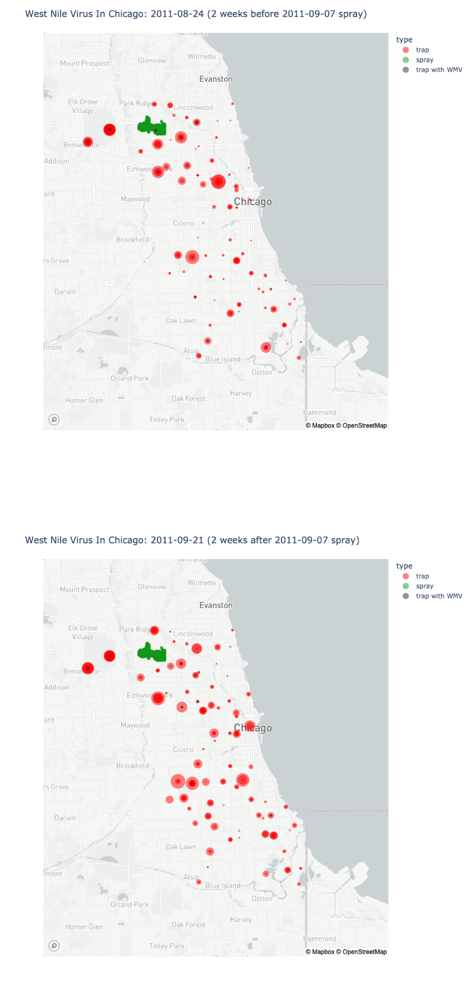

In [20]:
fig = plt.figure()

ax1 = fig.add_subplot(2,1,1)
ax2 = fig.add_subplot(2,1,2)

img1 = mpimg.imread(f'../images/spray_before_{image_date}.png')
ax1.imshow(img1)
ax1.axis('off')

img2 = mpimg.imread(f'../images/spray_after_{image_date}.png')
ax2.imshow(img2)
ax2.axis('off')

plt.subplots_adjust(wspace=0, hspace=0)
fig.set_figheight(90)
fig.set_figwidth(40)

# 3. Insecticide spray on 17-07-2013

## 3.1. 2 Weeks before 17-07-2013

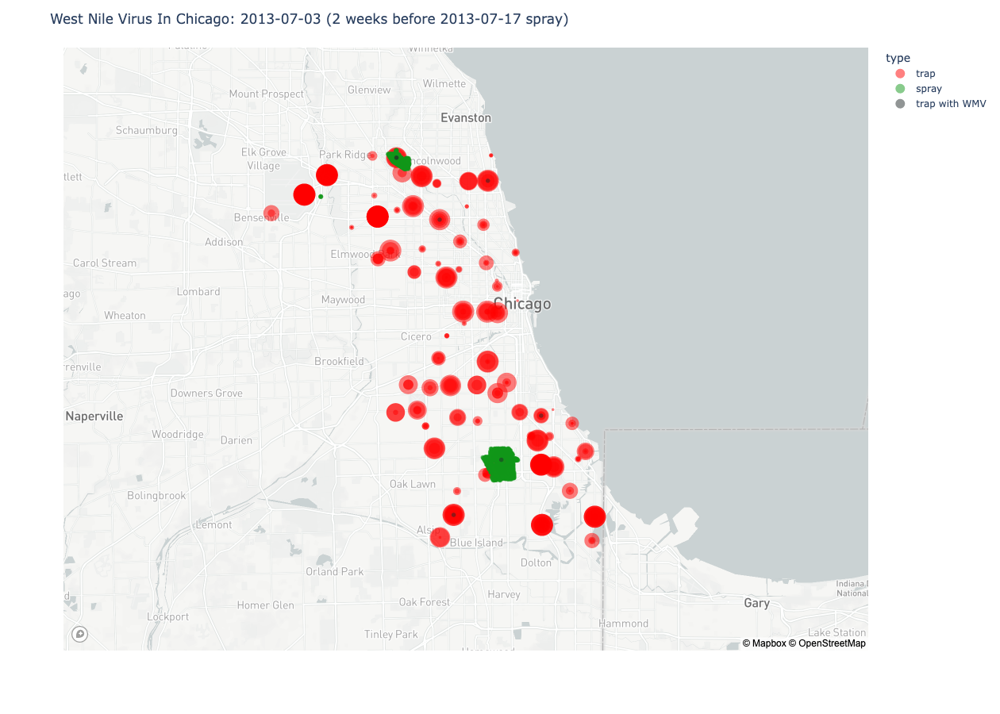

In [21]:
spray_date = pd.Timestamp(2013, 7, 17)

period_before = (spray_date - datetime.timedelta(weeks=2))
period_after= (spray_date + datetime.timedelta(weeks=2))





px.set_mapbox_access_token(MAPBOX_TOKEN)


fig = px.scatter_mapbox(merged[(merged.type=='trap') & (merged['date_datetime'] >= period_before) & (merged['date_datetime'] < spray_date)],
                        lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                        size='nummosquitos',
                        color_discrete_sequence=['red'],
                        opacity = 0.5,
                       zoom = 9.5) # size_max=15, 

fig2 = px.scatter_mapbox(merged[(merged.type=='spray') & (merged.date_datetime == spray_date)], lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                         color_discrete_sequence=['#109618'],
                        size_max=1, 
                         opacity=0.5,
                         zoom = 9.5)

fig3 = px.scatter_mapbox(merged_wmv_traps[(merged_wmv_traps.date_datetime >= period_before) & (merged_wmv_traps.date_datetime < spray_date)],
                         lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                         color_discrete_sequence=['#222A2A'],
                        size_max=1, 
                         opacity=0.5,
                         zoom =9.5)

fig.add_trace(fig2.data[0])
fig.add_trace(fig3.data[0])

image_date = merged[(merged.date_datetime == spray_date)].date.iloc[0]
period_before = period_before.date()

fig.update_layout(title = f'West Nile Virus In Chicago: {period_before} (2 weeks before {image_date} spray)',
                  mapbox_center={"lat": 41.834, "lon": -87.693}, # center map to a particular point
                  autosize=True,
                  width=900,
                  height=900,)

fig.show()
fig.write_image(f'../images/spray_before_{image_date}.png')

## 3.2. 2 Weeks After 17-07-2013

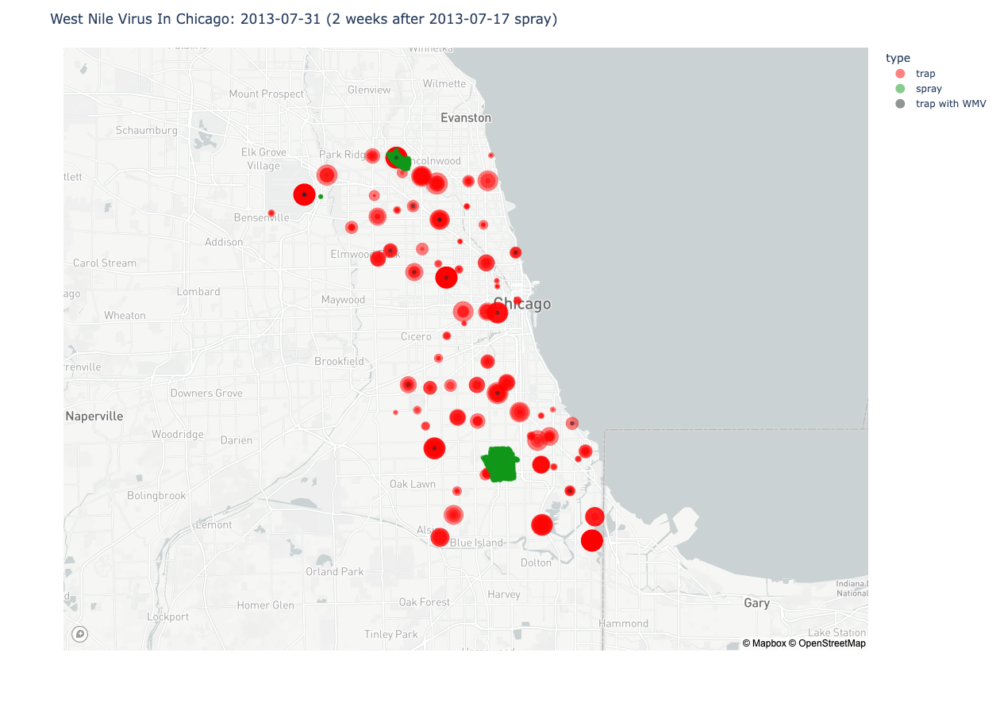

In [22]:
spray_date = pd.Timestamp(2013, 7, 17)

period_before = (spray_date - datetime.timedelta(weeks=2))
period_after= (spray_date + datetime.timedelta(weeks=2))





px.set_mapbox_access_token(MAPBOX_TOKEN)


fig = px.scatter_mapbox(merged[(merged.type=='trap') & (merged['date_datetime'] >= spray_date) & (merged['date_datetime'] <= period_after)],
                        lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                        size='nummosquitos',
                        color_discrete_sequence=['red'],
                        opacity = 0.5,
                       zoom = 9.5) # size_max=15, 

fig2 = px.scatter_mapbox(merged[(merged.type=='spray') & (merged.date_datetime == spray_date)], lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                         color_discrete_sequence=['#109618'],
                        size_max=1, 
                         opacity=0.5,
                         zoom = 9.5)

fig3 = px.scatter_mapbox(merged_wmv_traps[(merged_wmv_traps.date_datetime >= spray_date) & (merged_wmv_traps.date_datetime <= period_after)],
                         lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                         color_discrete_sequence=['#222A2A'],
                        size_max=1, 
                         opacity=0.5,
                         zoom =9.5)

fig.add_trace(fig2.data[0])
fig.add_trace(fig3.data[0])

image_date = merged[(merged.date_datetime == spray_date)].date.iloc[0]
period_after = period_after.date()

fig.update_layout(title = f'West Nile Virus In Chicago: {period_after} (2 weeks after {image_date} spray)',
                  mapbox_center={"lat": 41.834, "lon": -87.693}, # center map to a particular point
                  autosize=True,
                  width=900,
                  height=900,)

fig.show()
fig.write_image(f'../images/spray_after_{image_date}.png')

## 3.3. Side by side comparison of affected areas before and after 17-07-2013

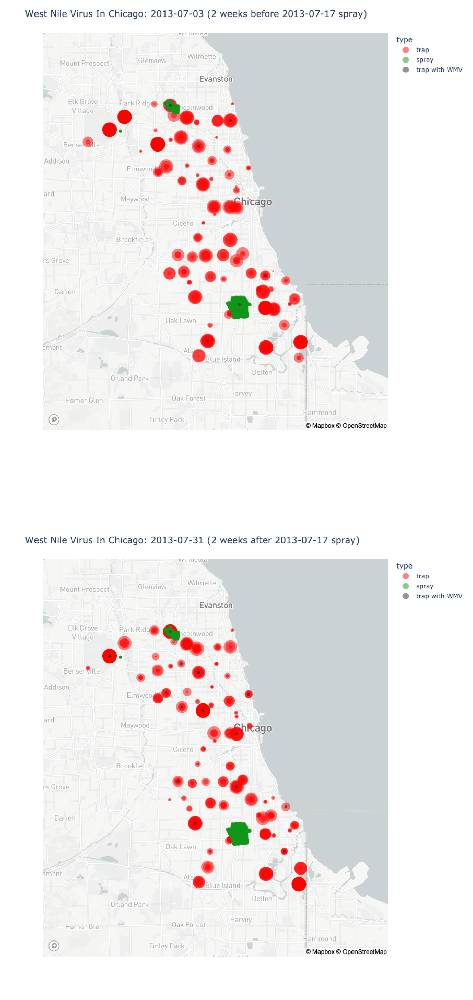

In [23]:
fig = plt.figure()

ax1 = fig.add_subplot(2,1,1)
ax2 = fig.add_subplot(2,1,2)

img1 = mpimg.imread(f'../images/spray_before_{image_date}.png')
ax1.imshow(img1)
ax1.axis('off')

img2 = mpimg.imread(f'../images/spray_after_{image_date}.png')
ax2.imshow(img2)
ax2.axis('off')

plt.subplots_adjust(wspace=0, hspace=0)
fig.set_figheight(90)
fig.set_figwidth(40)

# 4. Insecticide spray on 25-07-2013

## 4.1. 2 Weeks before 25-07-2013

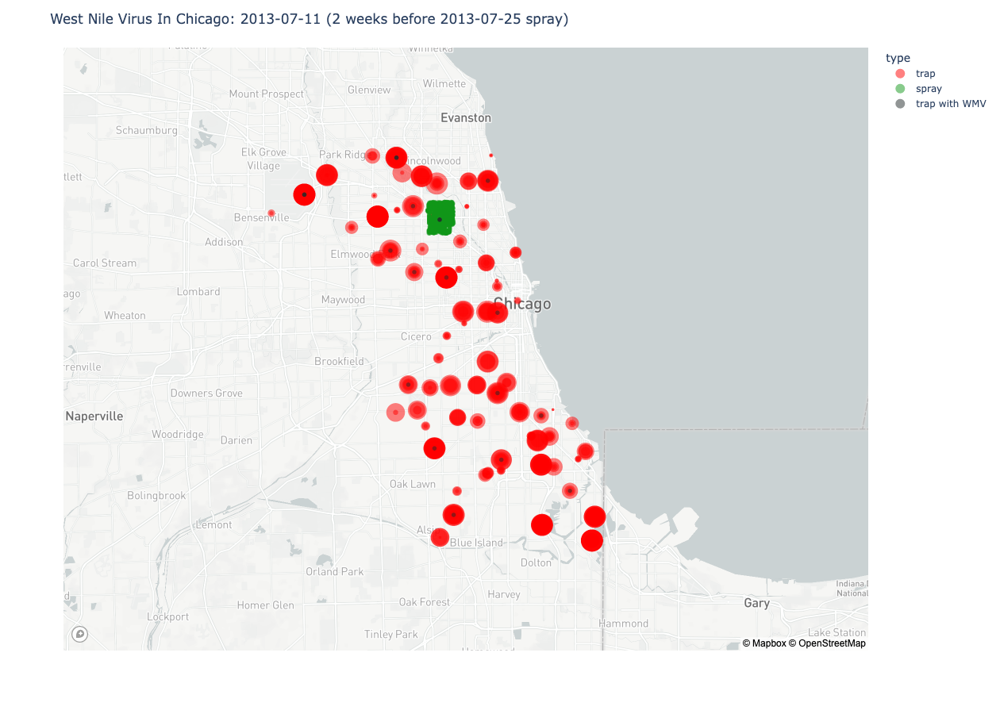

In [24]:
spray_date = pd.Timestamp(2013, 7, 25)

period_before = (spray_date - datetime.timedelta(weeks=2))
period_after= (spray_date + datetime.timedelta(weeks=2))





px.set_mapbox_access_token(MAPBOX_TOKEN)


fig = px.scatter_mapbox(merged[(merged.type=='trap') & (merged['date_datetime'] >= period_before) & (merged['date_datetime'] < spray_date)],
                        lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                        size='nummosquitos',
                        color_discrete_sequence=['red'],
                        opacity = 0.5,
                       zoom = 9.5) # size_max=15, 

fig2 = px.scatter_mapbox(merged[(merged.type=='spray') & (merged.date_datetime == spray_date)], lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                         color_discrete_sequence=['#109618'],
                        size_max=1, 
                         opacity=0.5,
                         zoom = 9.5)

fig3 = px.scatter_mapbox(merged_wmv_traps[(merged_wmv_traps.date_datetime >= period_before) & (merged_wmv_traps.date_datetime < spray_date)],
                         lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                         color_discrete_sequence=['#222A2A'],
                        size_max=1, 
                         opacity=0.5,
                         zoom =9.5)

fig.add_trace(fig2.data[0])
fig.add_trace(fig3.data[0])

image_date = merged[(merged.date_datetime == spray_date)].date.iloc[0]
period_before = period_before.date()

fig.update_layout(title = f'West Nile Virus In Chicago: {period_before} (2 weeks before {image_date} spray)',
                  mapbox_center={"lat": 41.834, "lon": -87.693}, # center map to a particular point
                  autosize=True,
                  width=900,
                  height=900,)

fig.show()
fig.write_image(f'../images/spray_before_{image_date}.png')

## 4.2. 2 Weeks After 25-07-2013

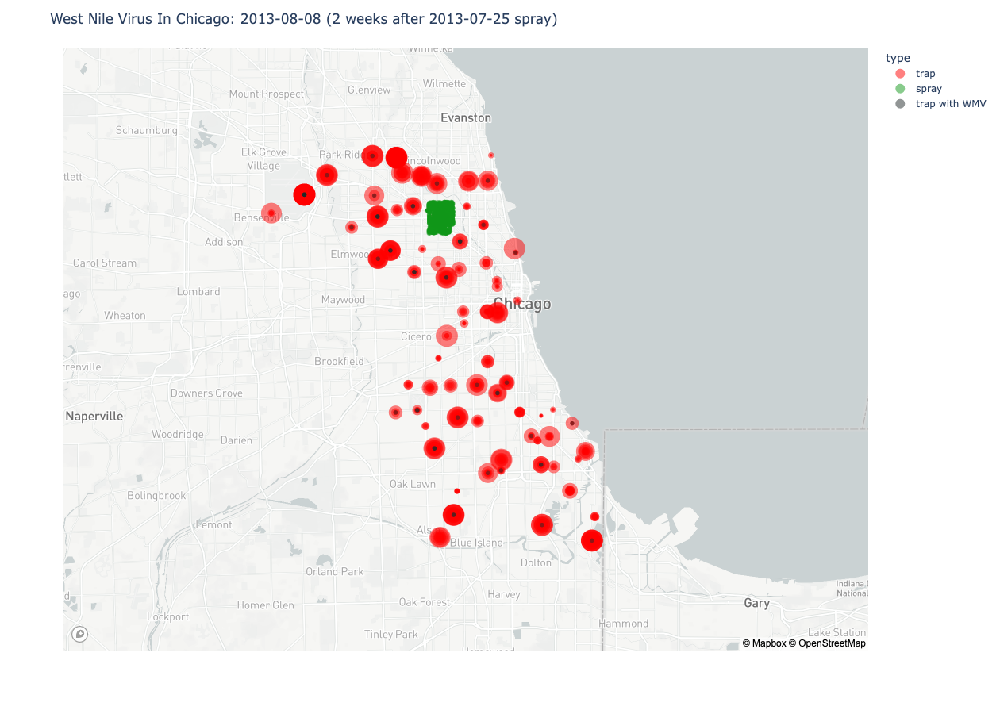

In [25]:
spray_date = pd.Timestamp(2013, 7, 25)

period_before = (spray_date - datetime.timedelta(weeks=2))
period_after= (spray_date + datetime.timedelta(weeks=2))





px.set_mapbox_access_token(MAPBOX_TOKEN)


fig = px.scatter_mapbox(merged[(merged.type=='trap') & (merged['date_datetime'] >= spray_date) & (merged['date_datetime'] <= period_after)],
                        lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                        size='nummosquitos',
                        color_discrete_sequence=['red'],
                        opacity = 0.5,
                       zoom = 9.5) # size_max=15, 

fig2 = px.scatter_mapbox(merged[(merged.type=='spray') & (merged.date_datetime == spray_date)], lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                         color_discrete_sequence=['#109618'],
                        size_max=1, 
                         opacity=0.5,
                         zoom = 9.5)

fig3 = px.scatter_mapbox(merged_wmv_traps[(merged_wmv_traps.date_datetime >= spray_date) & (merged_wmv_traps.date_datetime <= period_after)],
                         lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                         color_discrete_sequence=['#222A2A'],
                        size_max=1, 
                         opacity=0.5,
                         zoom =9.5)

fig.add_trace(fig2.data[0])
fig.add_trace(fig3.data[0])

image_date = merged[(merged.date_datetime == spray_date)].date.iloc[0]
period_after = period_after.date()

fig.update_layout(title = f'West Nile Virus In Chicago: {period_after} (2 weeks after {image_date} spray)',
                  mapbox_center={"lat": 41.834, "lon": -87.693}, # center map to a particular point
                  autosize=True,
                  width=900,
                  height=900,)

fig.show()
fig.write_image(f'../images/spray_after_{image_date}.png')

## 4.3. Side by side comparison of affected areas before and after 25-07-2013

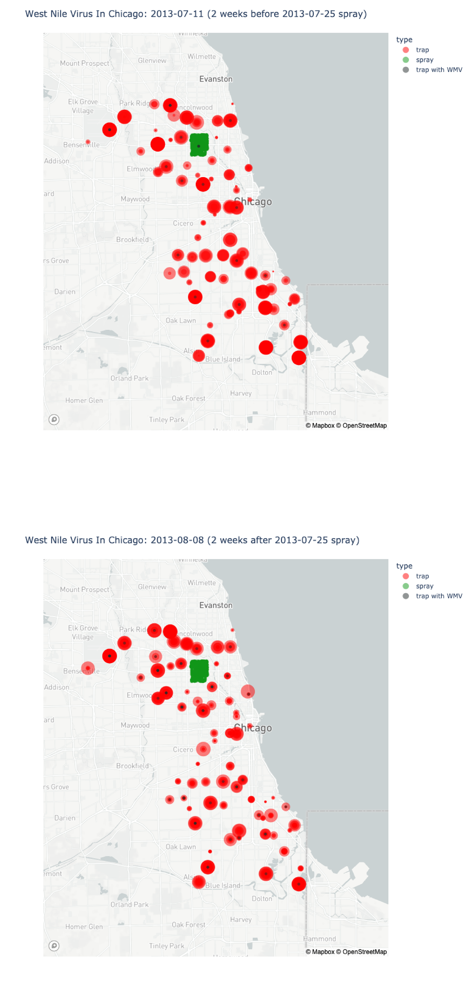

In [26]:
fig = plt.figure()

ax1 = fig.add_subplot(2,1,1)
ax2 = fig.add_subplot(2,1,2)

img1 = mpimg.imread(f'../images/spray_before_{image_date}.png')
ax1.imshow(img1)
ax1.axis('off')

img2 = mpimg.imread(f'../images/spray_after_{image_date}.png')
ax2.imshow(img2)
ax2.axis('off')

plt.subplots_adjust(wspace=0, hspace=0)
fig.set_figheight(90)
fig.set_figwidth(40)

# 5. Insecticide spray on 08-08-2013

## 5.1. 2 Weeks before 08-08-2013

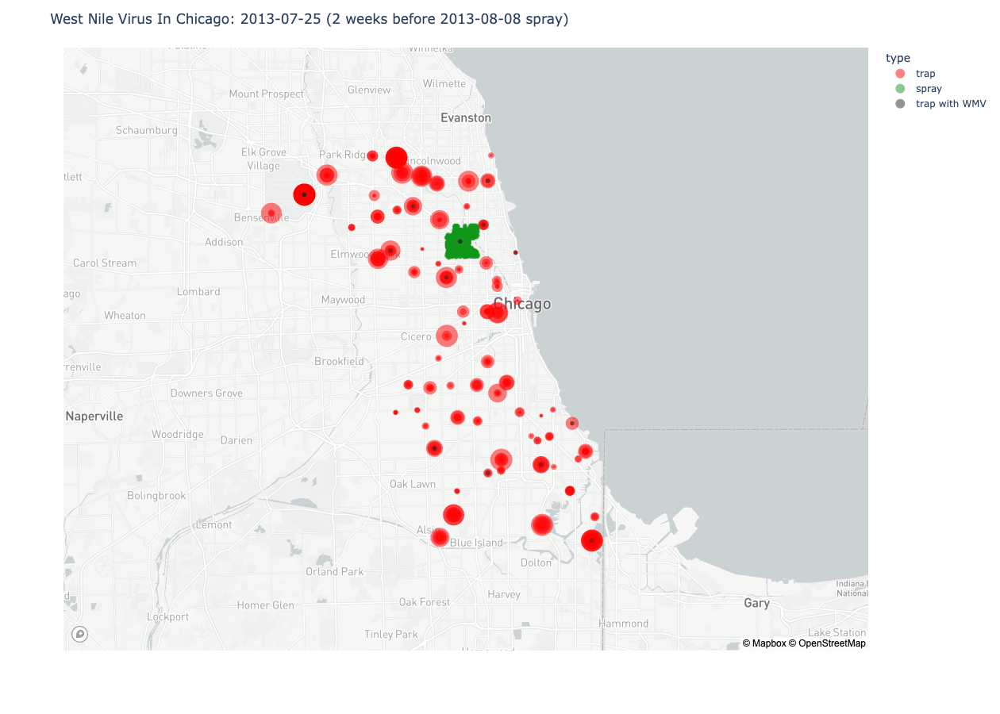

In [27]:
spray_date = pd.Timestamp(2013, 8, 8)

period_before = (spray_date - datetime.timedelta(weeks=2))
period_after= (spray_date + datetime.timedelta(weeks=2))





px.set_mapbox_access_token(MAPBOX_TOKEN)


fig = px.scatter_mapbox(merged[(merged.type=='trap') & (merged['date_datetime'] >= period_before) & (merged['date_datetime'] < spray_date)],
                        lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                        size='nummosquitos',
                        color_discrete_sequence=['red'],
                        opacity = 0.5,
                       zoom = 9.5) # size_max=15, 

fig2 = px.scatter_mapbox(merged[(merged.type=='spray') & (merged.date_datetime == spray_date)], lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                         color_discrete_sequence=['#109618'],
                        size_max=1, 
                         opacity=0.5,
                         zoom = 9.5)

fig3 = px.scatter_mapbox(merged_wmv_traps[(merged_wmv_traps.date_datetime >= period_before) & (merged_wmv_traps.date_datetime < spray_date)],
                         lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                         color_discrete_sequence=['#222A2A'],
                        size_max=1, 
                         opacity=0.5,
                         zoom =9.5)

fig.add_trace(fig2.data[0])
fig.add_trace(fig3.data[0])

image_date = merged[(merged.date_datetime == spray_date)].date.iloc[0]
period_before = period_before.date()

fig.update_layout(title = f'West Nile Virus In Chicago: {period_before} (2 weeks before {image_date} spray)',
                  mapbox_center={"lat": 41.834, "lon": -87.693}, # center map to a particular point
                  autosize=True,
                  width=900,
                  height=900,)

fig.show()
fig.write_image(f'../images/spray_before_{image_date}.png')

## 5.2. 2 Weeks After 08-08-2013

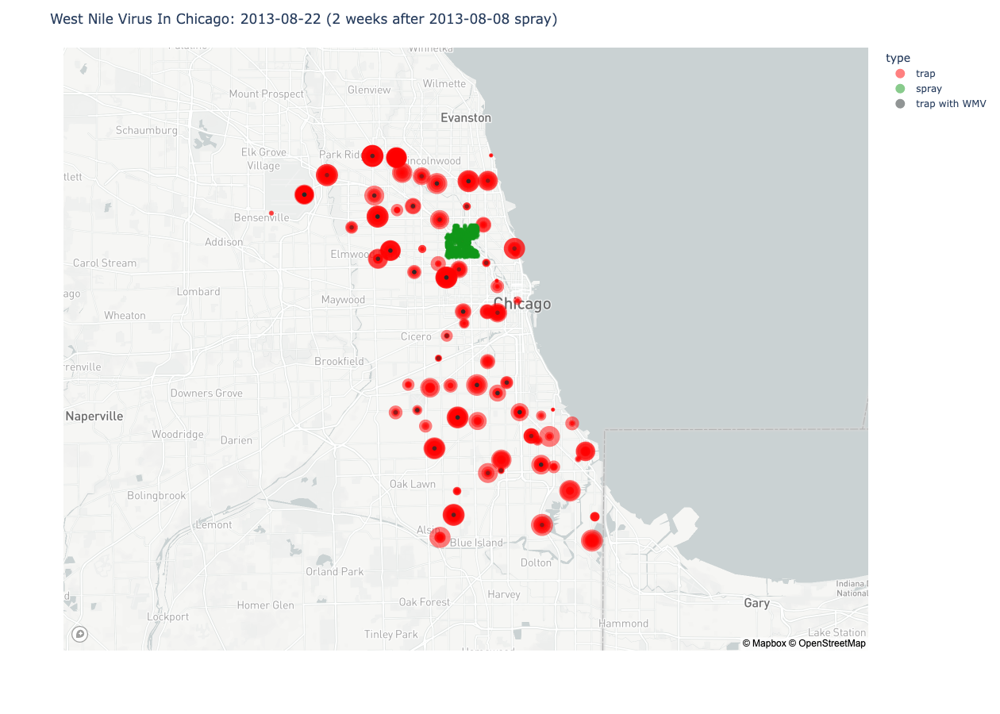

In [28]:
spray_date = pd.Timestamp(2013, 8, 8)

period_before = (spray_date - datetime.timedelta(weeks=2))
period_after= (spray_date + datetime.timedelta(weeks=2))





px.set_mapbox_access_token(MAPBOX_TOKEN)


fig = px.scatter_mapbox(merged[(merged.type=='trap') & (merged['date_datetime'] >= spray_date) & (merged['date_datetime'] <= period_after)],
                        lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                        size='nummosquitos',
                        color_discrete_sequence=['red'],
                        opacity = 0.5,
                       zoom = 9.5) # size_max=15, 

fig2 = px.scatter_mapbox(merged[(merged.type=='spray') & (merged.date_datetime == spray_date)], lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                         color_discrete_sequence=['#109618'],
                        size_max=1, 
                         opacity=0.5,
                         zoom = 9.5)

fig3 = px.scatter_mapbox(merged_wmv_traps[(merged_wmv_traps.date_datetime >= spray_date) & (merged_wmv_traps.date_datetime <= period_after)],
                         lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                         color_discrete_sequence=['#222A2A'],
                        size_max=1, 
                         opacity=0.5,
                         zoom =9.5)

fig.add_trace(fig2.data[0])
fig.add_trace(fig3.data[0])

image_date = merged[(merged.date_datetime == spray_date)].date.iloc[0]
period_after = period_after.date()

fig.update_layout(title = f'West Nile Virus In Chicago: {period_after} (2 weeks after {image_date} spray)',
                  mapbox_center={"lat": 41.834, "lon": -87.693}, # center map to a particular point
                  autosize=True,
                  width=900,
                  height=900,)

fig.show()
fig.write_image(f'../images/spray_after_{image_date}.png')

## 5.3. Side by side comparison of affected areas before and after 08-08-2013

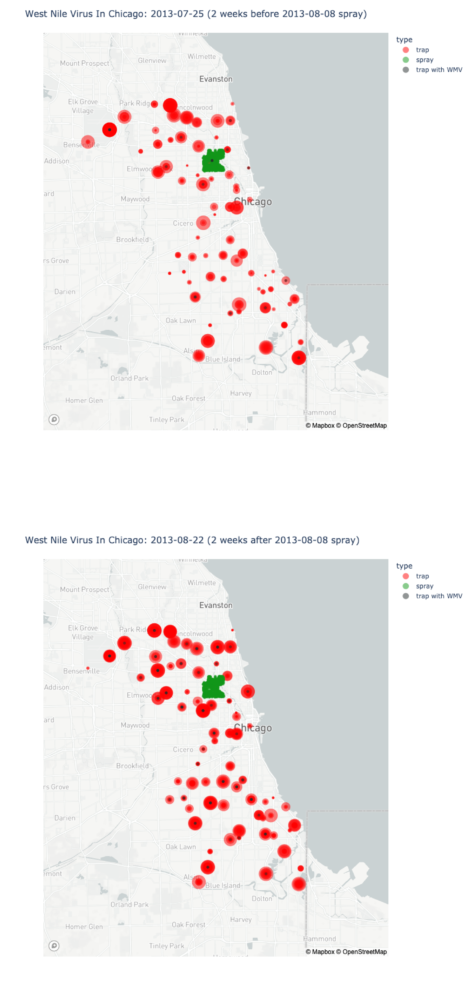

In [29]:
fig = plt.figure()

ax1 = fig.add_subplot(2,1,1)
ax2 = fig.add_subplot(2,1,2)

img1 = mpimg.imread(f'../images/spray_before_{image_date}.png')
ax1.imshow(img1)
ax1.axis('off')

img2 = mpimg.imread(f'../images/spray_after_{image_date}.png')
ax2.imshow(img2)
ax2.axis('off')

plt.subplots_adjust(wspace=0, hspace=0)
fig.set_figheight(90)
fig.set_figwidth(40)

# 6. Insecticide spray on 15-08-2013

## 6.1. 2 Weeks before 15-08-2013

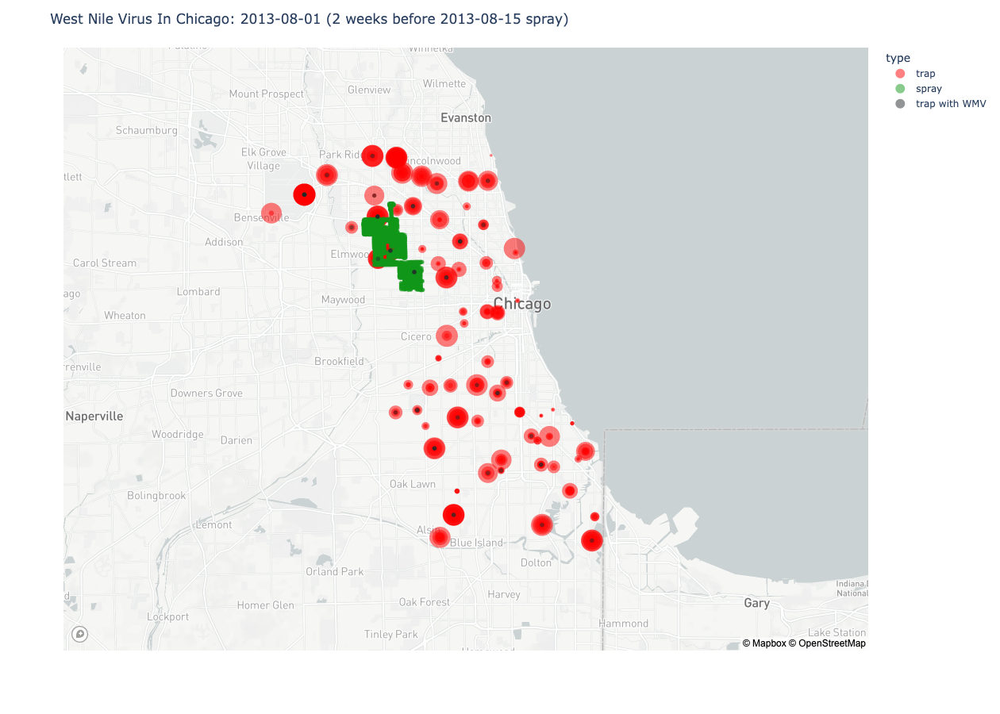

In [30]:
spray_date = pd.Timestamp(2013, 8, 15)

period_before = (spray_date - datetime.timedelta(weeks=2))
period_after= (spray_date + datetime.timedelta(weeks=2))





px.set_mapbox_access_token(MAPBOX_TOKEN)


fig = px.scatter_mapbox(merged[(merged.type=='trap') & (merged['date_datetime'] >= period_before) & (merged['date_datetime'] < spray_date)],
                        lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                        size='nummosquitos',
                        color_discrete_sequence=['red'],
                        opacity = 0.5,
                       zoom = 9.5) # size_max=15, 

fig2 = px.scatter_mapbox(merged[(merged.type=='spray') & (merged.date_datetime == spray_date)], lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                         color_discrete_sequence=['#109618'],
                        size_max=1, 
                         opacity=0.5,
                         zoom = 9.5)

fig3 = px.scatter_mapbox(merged_wmv_traps[(merged_wmv_traps.date_datetime >= period_before) & (merged_wmv_traps.date_datetime < spray_date)],
                         lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                         color_discrete_sequence=['#222A2A'],
                        size_max=1, 
                         opacity=0.5,
                         zoom =9.5)

fig.add_trace(fig2.data[0])
fig.add_trace(fig3.data[0])

image_date = merged[(merged.date_datetime == spray_date)].date.iloc[0]
period_before = period_before.date()

fig.update_layout(title = f'West Nile Virus In Chicago: {period_before} (2 weeks before {image_date} spray)',
                  mapbox_center={"lat": 41.834, "lon": -87.693}, # center map to a particular point
                  autosize=True,
                  width=900,
                  height=900,)

fig.show()
fig.write_image(f'../images/spray_before_{image_date}.png')

## 6.2. 2 Weeks After 15-08-2013

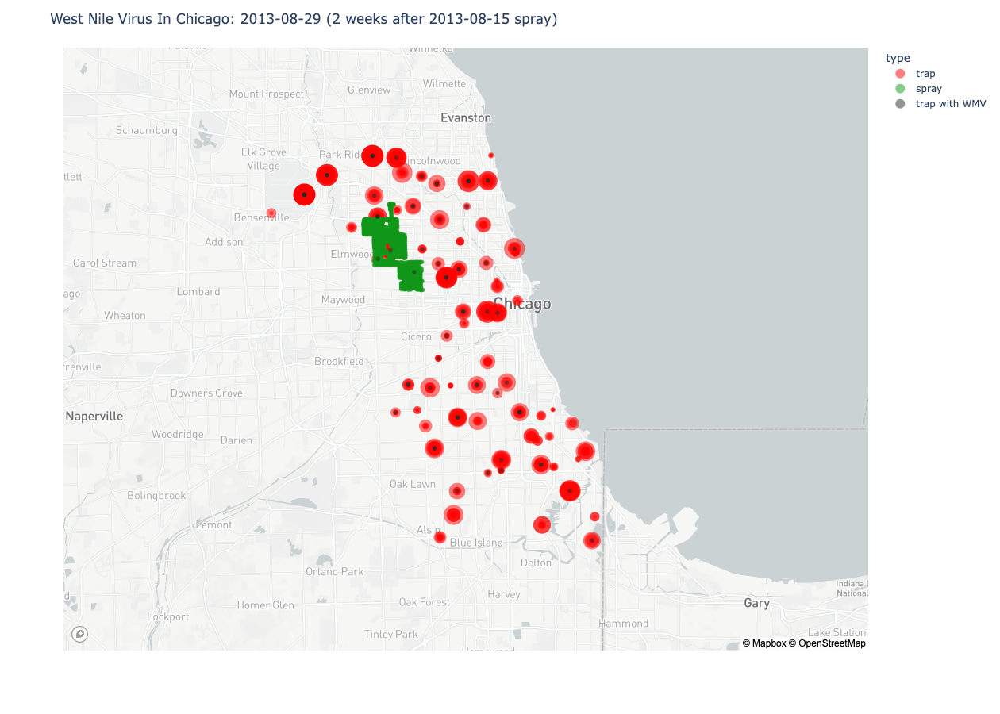

In [31]:
spray_date = pd.Timestamp(2013, 8, 15)

period_before = (spray_date - datetime.timedelta(weeks=2))
period_after= (spray_date + datetime.timedelta(weeks=2))





px.set_mapbox_access_token(MAPBOX_TOKEN)


fig = px.scatter_mapbox(merged[(merged.type=='trap') & (merged['date_datetime'] >= spray_date) & (merged['date_datetime'] <= period_after)],
                        lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                        size='nummosquitos',
                        color_discrete_sequence=['red'],
                        opacity = 0.5,
                       zoom = 9.5) # size_max=15, 

fig2 = px.scatter_mapbox(merged[(merged.type=='spray') & (merged.date_datetime == spray_date)], lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                         color_discrete_sequence=['#109618'],
                        size_max=1, 
                         opacity=0.5,
                         zoom = 9.5)

fig3 = px.scatter_mapbox(merged_wmv_traps[(merged_wmv_traps.date_datetime >= spray_date) & (merged_wmv_traps.date_datetime <= period_after)],
                         lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                         color_discrete_sequence=['#222A2A'],
                        size_max=1, 
                         opacity=0.5,
                         zoom =9.5)

fig.add_trace(fig2.data[0])
fig.add_trace(fig3.data[0])

image_date = merged[(merged.date_datetime == spray_date)].date.iloc[0]
period_after = period_after.date()

fig.update_layout(title = f'West Nile Virus In Chicago: {period_after} (2 weeks after {image_date} spray)',
                  mapbox_center={"lat": 41.834, "lon": -87.693}, # center map to a particular point
                  autosize=True,
                  width=900,
                  height=900,)

fig.show()
fig.write_image(f'../images/spray_after_{image_date}.png')

## 6.3. Side by side comparison of affected areas before and after 15-08-2013

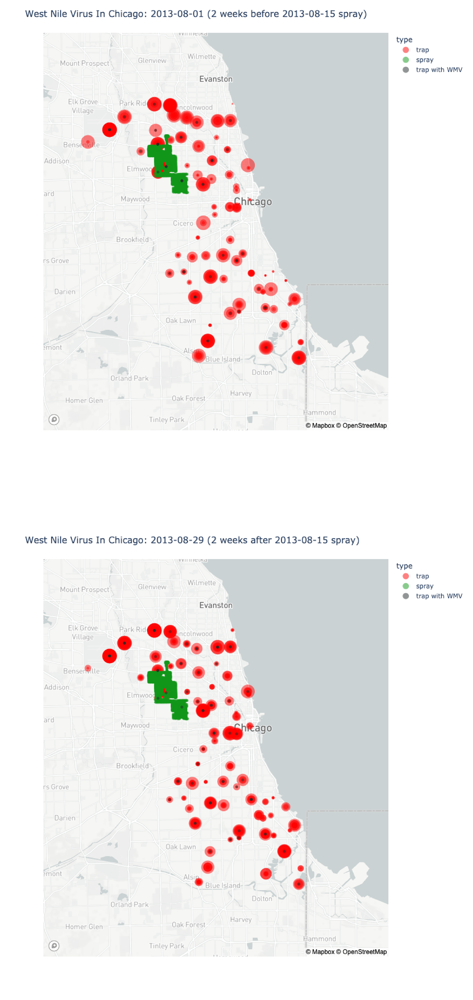

In [32]:
fig = plt.figure()

ax1 = fig.add_subplot(2,1,1)
ax2 = fig.add_subplot(2,1,2)

img1 = mpimg.imread(f'../images/spray_before_{image_date}.png')
ax1.imshow(img1)
ax1.axis('off')

img2 = mpimg.imread(f'../images/spray_after_{image_date}.png')
ax2.imshow(img2)
ax2.axis('off')

plt.subplots_adjust(wspace=0, hspace=0)
fig.set_figheight(90)
fig.set_figwidth(40)

# 7. Insecticide spray on 16-08-2013

## 7.1. 2 Weeks before 16-08-2013** 

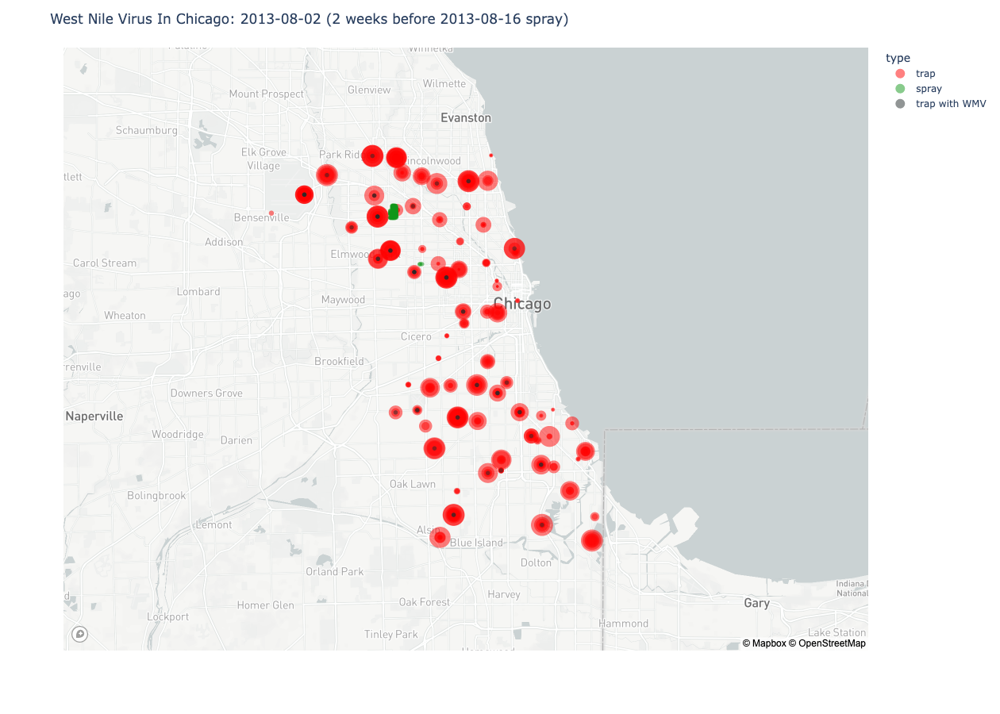

In [33]:
spray_date = pd.Timestamp(2013, 8, 16)

period_before = (spray_date - datetime.timedelta(weeks=2))
period_after= (spray_date + datetime.timedelta(weeks=2))





px.set_mapbox_access_token(MAPBOX_TOKEN)


fig = px.scatter_mapbox(merged[(merged.type=='trap') & (merged['date_datetime'] >= period_before) & (merged['date_datetime'] < spray_date)],
                        lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                        size='nummosquitos',
                        color_discrete_sequence=['red'],
                        opacity = 0.5,
                       zoom = 9.5) # size_max=15, 

fig2 = px.scatter_mapbox(merged[(merged.type=='spray') & (merged.date_datetime == spray_date)], lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                         color_discrete_sequence=['#109618'],
                        size_max=1, 
                         opacity=0.5,
                         zoom = 9.5)

fig3 = px.scatter_mapbox(merged_wmv_traps[(merged_wmv_traps.date_datetime >= period_before) & (merged_wmv_traps.date_datetime < spray_date)],
                         lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                         color_discrete_sequence=['#222A2A'],
                        size_max=1, 
                         opacity=0.5,
                         zoom =9.5)

fig.add_trace(fig2.data[0])
fig.add_trace(fig3.data[0])

image_date = merged[(merged.date_datetime == spray_date)].date.iloc[0]
period_before = period_before.date()

fig.update_layout(title = f'West Nile Virus In Chicago: {period_before} (2 weeks before {image_date} spray)',
                  mapbox_center={"lat": 41.834, "lon": -87.693}, # center map to a particular point
                  autosize=True,
                  width=900,
                  height=900,)

fig.show()
fig.write_image(f'../images/spray_before_{image_date}.png')

## 7.2. 2 Weeks After 16-08-2013

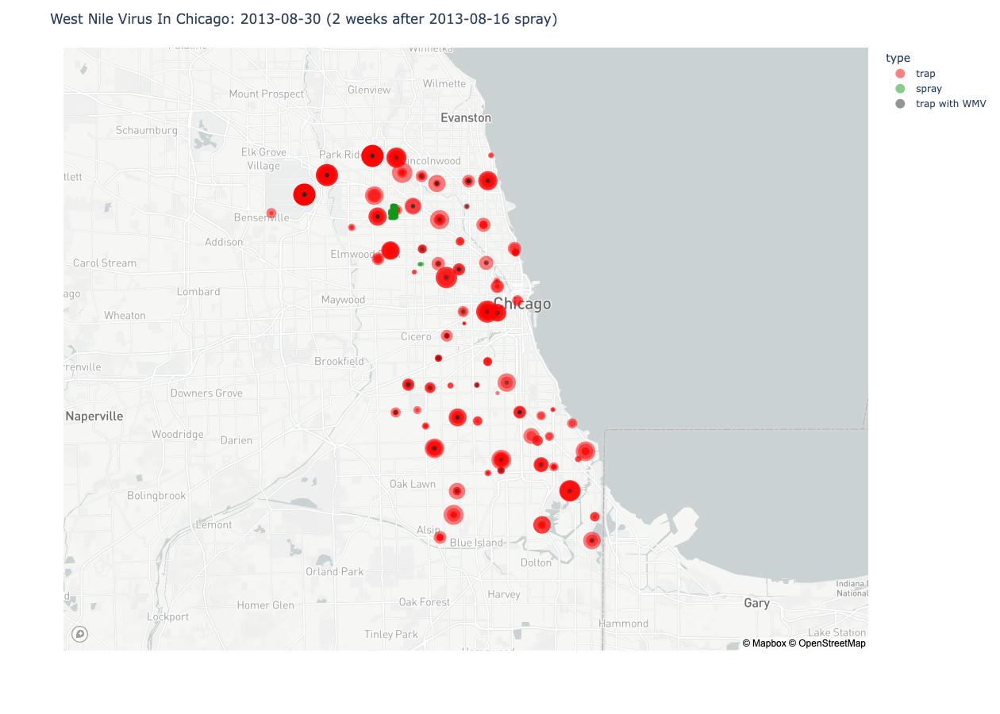

In [34]:
spray_date = pd.Timestamp(2013, 8, 16)

period_before = (spray_date - datetime.timedelta(weeks=2))
period_after= (spray_date + datetime.timedelta(weeks=2))





px.set_mapbox_access_token(MAPBOX_TOKEN)


fig = px.scatter_mapbox(merged[(merged.type=='trap') & (merged['date_datetime'] >= spray_date) & (merged['date_datetime'] <= period_after)],
                        lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                        size='nummosquitos',
                        color_discrete_sequence=['red'],
                        opacity = 0.5,
                       zoom = 9.5) # size_max=15, 

fig2 = px.scatter_mapbox(merged[(merged.type=='spray') & (merged.date_datetime == spray_date)], lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                         color_discrete_sequence=['#109618'],
                        size_max=1, 
                         opacity=0.5,
                         zoom = 9.5)

fig3 = px.scatter_mapbox(merged_wmv_traps[(merged_wmv_traps.date_datetime >= spray_date) & (merged_wmv_traps.date_datetime <= period_after)],
                         lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                         color_discrete_sequence=['#222A2A'],
                        size_max=1, 
                         opacity=0.5,
                         zoom =9.5)

fig.add_trace(fig2.data[0])
fig.add_trace(fig3.data[0])

image_date = merged[(merged.date_datetime == spray_date)].date.iloc[0]
period_after = period_after.date()

fig.update_layout(title = f'West Nile Virus In Chicago: {period_after} (2 weeks after {image_date} spray)',
                  mapbox_center={"lat": 41.834, "lon": -87.693}, # center map to a particular point
                  autosize=True,
                  width=900,
                  height=900,)

fig.show()
fig.write_image(f'../images/spray_after_{image_date}.png')

## 7.3. Side by side comparison of affected areas before and after 16-08-2011

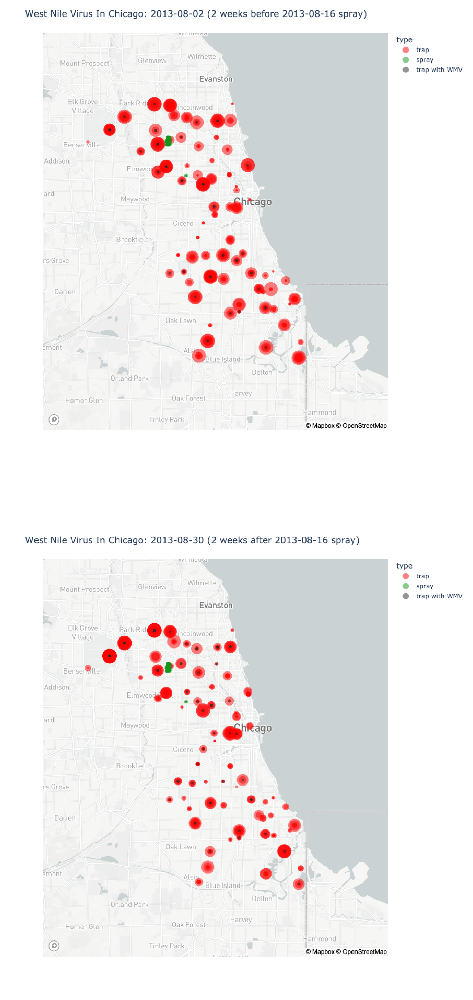

In [35]:
fig = plt.figure()

ax1 = fig.add_subplot(2,1,1)
ax2 = fig.add_subplot(2,1,2)

img1 = mpimg.imread(f'../images/spray_before_{image_date}.png')
ax1.imshow(img1)
ax1.axis('off')

img2 = mpimg.imread(f'../images/spray_after_{image_date}.png')
ax2.imshow(img2)
ax2.axis('off')

plt.subplots_adjust(wspace=0, hspace=0)
fig.set_figheight(90)
fig.set_figwidth(40)

# 8. Insecticide spray on 22-08-2013

## 8.1. 2 Weeks before 22-08-2013

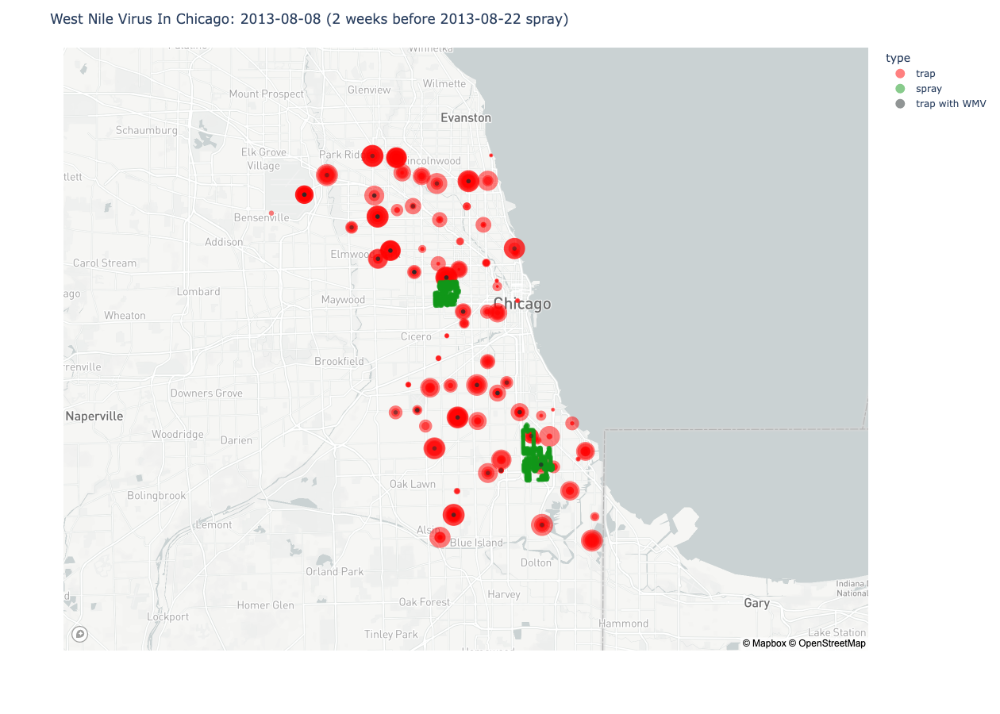

In [36]:
spray_date = pd.Timestamp(2013, 8, 22)

period_before = (spray_date - datetime.timedelta(weeks=2))
period_after= (spray_date + datetime.timedelta(weeks=2))





px.set_mapbox_access_token(MAPBOX_TOKEN)


fig = px.scatter_mapbox(merged[(merged.type=='trap') & (merged['date_datetime'] >= period_before) & (merged['date_datetime'] < spray_date)],
                        lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                        size='nummosquitos',
                        color_discrete_sequence=['red'],
                        opacity = 0.5,
                       zoom = 9.5) # size_max=15, 

fig2 = px.scatter_mapbox(merged[(merged.type=='spray') & (merged.date_datetime == spray_date)], lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                         color_discrete_sequence=['#109618'],
                        size_max=1, 
                         opacity=0.5,
                         zoom = 9.5)

fig3 = px.scatter_mapbox(merged_wmv_traps[(merged_wmv_traps.date_datetime >= period_before) & (merged_wmv_traps.date_datetime < spray_date)],
                         lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                         color_discrete_sequence=['#222A2A'],
                        size_max=1, 
                         opacity=0.5,
                         zoom =9.5)

fig.add_trace(fig2.data[0])
fig.add_trace(fig3.data[0])

image_date = merged[(merged.date_datetime == spray_date)].date.iloc[0]
period_before = period_before.date()

fig.update_layout(title = f'West Nile Virus In Chicago: {period_before} (2 weeks before {image_date} spray)',
                  mapbox_center={"lat": 41.834, "lon": -87.693}, # center map to a particular point
                  autosize=True,
                  width=900,
                  height=900,)

fig.show()
fig.write_image(f'../images/spray_before_{image_date}.png')

## 8.2. 2 Weeks After 22-08-2013

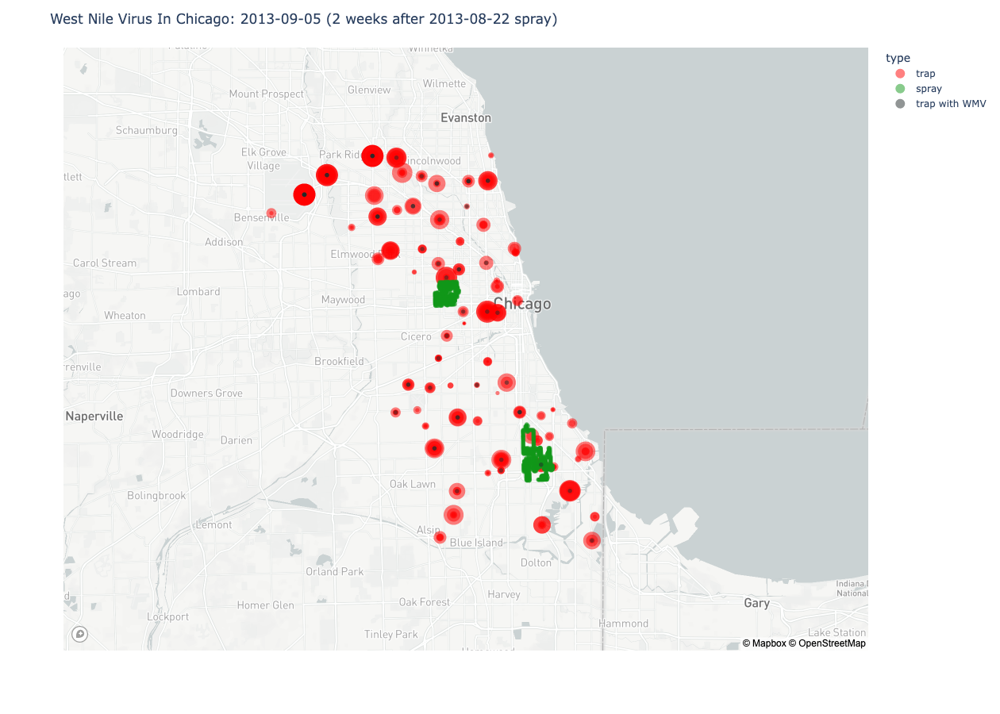

In [37]:
spray_date = pd.Timestamp(2013, 8, 22)

period_before = (spray_date - datetime.timedelta(weeks=2))
period_after= (spray_date + datetime.timedelta(weeks=2))





px.set_mapbox_access_token(MAPBOX_TOKEN)


fig = px.scatter_mapbox(merged[(merged.type=='trap') & (merged['date_datetime'] >= spray_date) & (merged['date_datetime'] <= period_after)],
                        lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                        size='nummosquitos',
                        color_discrete_sequence=['red'],
                        opacity = 0.5,
                       zoom = 9.5) # size_max=15, 

fig2 = px.scatter_mapbox(merged[(merged.type=='spray') & (merged.date_datetime == spray_date)], lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                         color_discrete_sequence=['#109618'],
                        size_max=1, 
                         opacity=0.5,
                         zoom = 9.5)

fig3 = px.scatter_mapbox(merged_wmv_traps[(merged_wmv_traps.date_datetime >= spray_date) & (merged_wmv_traps.date_datetime <= period_after)],
                         lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                         color_discrete_sequence=['#222A2A'],
                        size_max=1, 
                         opacity=0.5,
                         zoom =9.5)

fig.add_trace(fig2.data[0])
fig.add_trace(fig3.data[0])

image_date = merged[(merged.date_datetime == spray_date)].date.iloc[0]
period_after = period_after.date()

fig.update_layout(title = f'West Nile Virus In Chicago: {period_after} (2 weeks after {image_date} spray)',
                  mapbox_center={"lat": 41.834, "lon": -87.693}, # center map to a particular point
                  autosize=True,
                  width=900,
                  height=900,)

fig.show()
fig.write_image(f'../images/spray_after_{image_date}.png')

## 8.3. Side by side comparison of affected areas before and after 22-08-2013

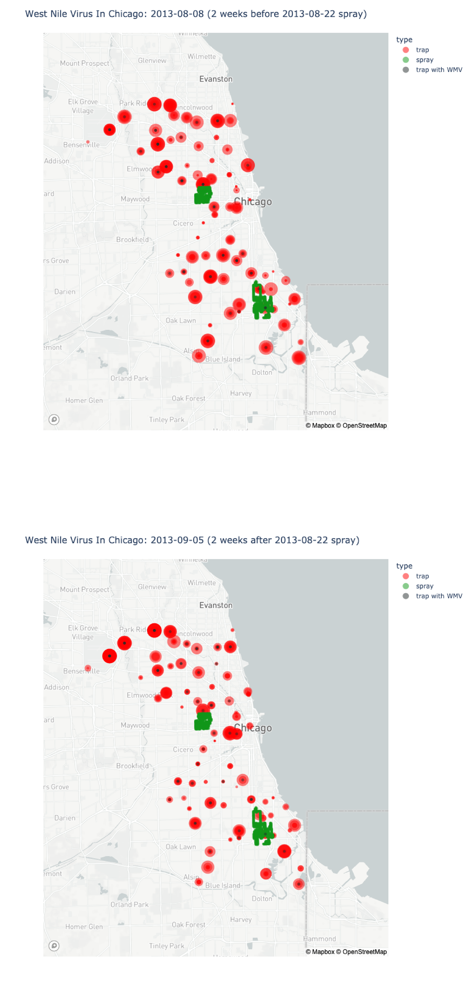

In [38]:
fig = plt.figure()

ax1 = fig.add_subplot(2,1,1)
ax2 = fig.add_subplot(2,1,2)

img1 = mpimg.imread(f'../images/spray_before_{image_date}.png')
ax1.imshow(img1)
ax1.axis('off')

img2 = mpimg.imread(f'../images/spray_after_{image_date}.png')
ax2.imshow(img2)
ax2.axis('off')

plt.subplots_adjust(wspace=0, hspace=0)
fig.set_figheight(90)
fig.set_figwidth(40)

# 9. Insecticide spray on 29-08-2013

## 9.1. 2 Weeks before 29-08-2013

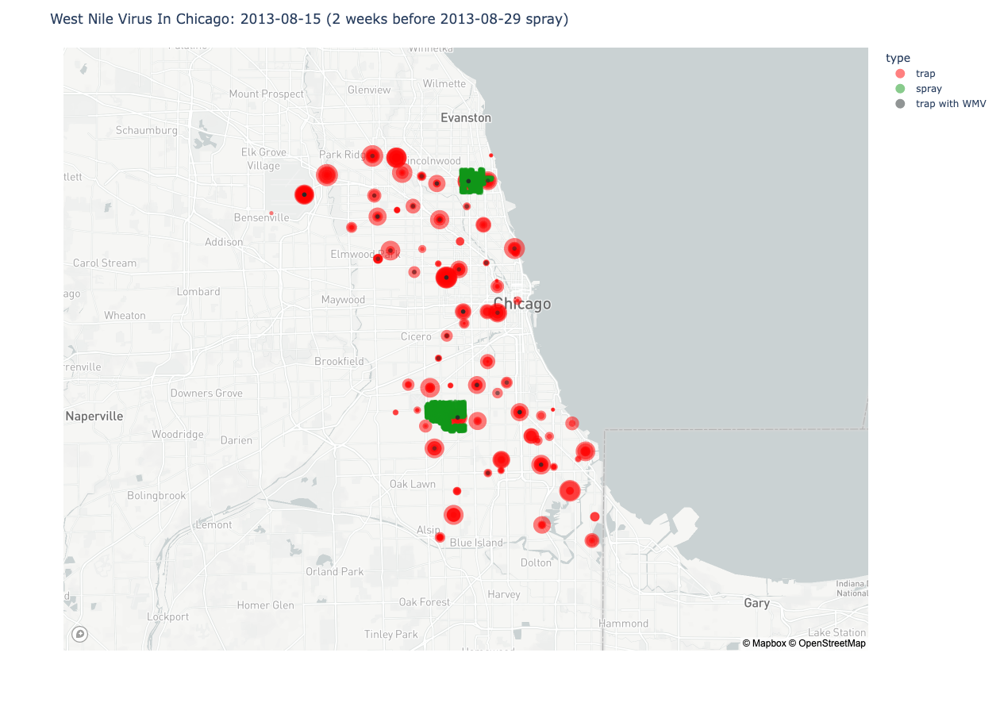

In [39]:
spray_date = pd.Timestamp(2013, 8, 29)

period_before = (spray_date - datetime.timedelta(weeks=2))
period_after= (spray_date + datetime.timedelta(weeks=2))





px.set_mapbox_access_token(MAPBOX_TOKEN)


fig = px.scatter_mapbox(merged[(merged.type=='trap') & (merged['date_datetime'] >= period_before) & (merged['date_datetime'] < spray_date)],
                        lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                        size='nummosquitos',
                        color_discrete_sequence=['red'],
                        opacity = 0.5,
                       zoom = 9.5) # size_max=15, 

fig2 = px.scatter_mapbox(merged[(merged.type=='spray') & (merged.date_datetime == spray_date)], lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                         color_discrete_sequence=['#109618'],
                        size_max=1, 
                         opacity=0.5,
                         zoom = 9.5)

fig3 = px.scatter_mapbox(merged_wmv_traps[(merged_wmv_traps.date_datetime >= period_before) & (merged_wmv_traps.date_datetime < spray_date)],
                         lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                         color_discrete_sequence=['#222A2A'],
                        size_max=1, 
                         opacity=0.5,
                         zoom =9.5)

fig.add_trace(fig2.data[0])
fig.add_trace(fig3.data[0])

image_date = merged[(merged.date_datetime == spray_date)].date.iloc[0]
period_before = period_before.date()

fig.update_layout(title = f'West Nile Virus In Chicago: {period_before} (2 weeks before {image_date} spray)',
                  mapbox_center={"lat": 41.834, "lon": -87.693}, # center map to a particular point
                  autosize=True,
                  width=900,
                  height=900,)

fig.show()
fig.write_image(f'../images/spray_before_{image_date}.png')

## 9.2. 2 Weeks After 29-08-2013

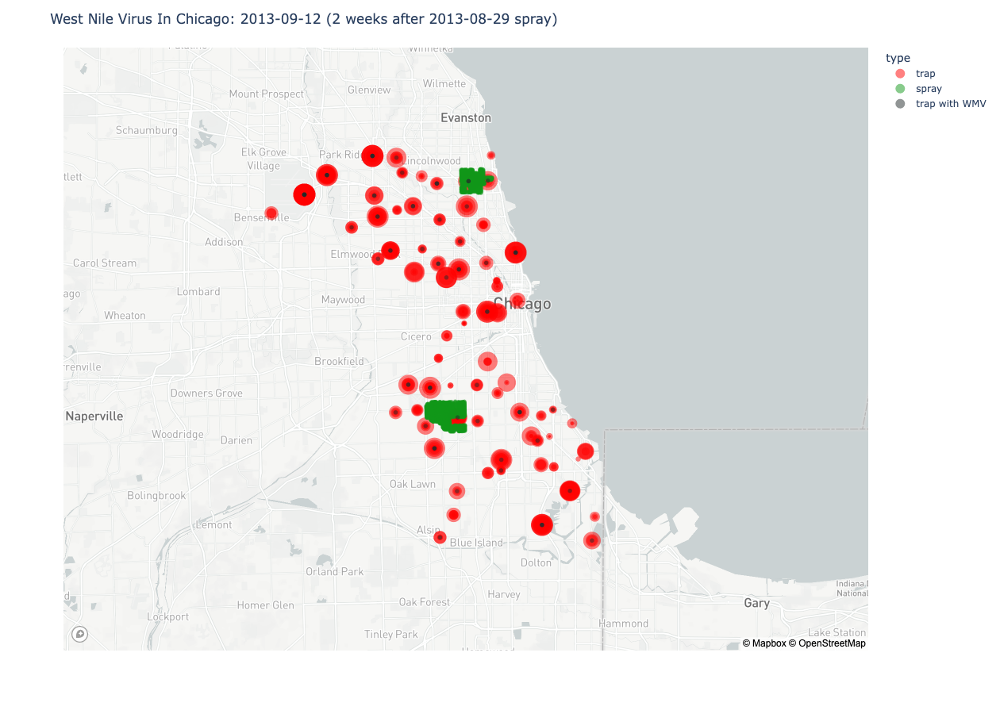

In [40]:
spray_date = pd.Timestamp(2013, 8, 29)

period_before = (spray_date - datetime.timedelta(weeks=2))
period_after= (spray_date + datetime.timedelta(weeks=2))





px.set_mapbox_access_token(MAPBOX_TOKEN)


fig = px.scatter_mapbox(merged[(merged.type=='trap') & (merged['date_datetime'] >= spray_date) & (merged['date_datetime'] <= period_after)],
                        lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                        size='nummosquitos',
                        color_discrete_sequence=['red'],
                        opacity = 0.5,
                       zoom = 9.5) # size_max=15, 

fig2 = px.scatter_mapbox(merged[(merged.type=='spray') & (merged.date_datetime == spray_date)], lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                         color_discrete_sequence=['#109618'],
                        size_max=1, 
                         opacity=0.5,
                         zoom = 9.5)

fig3 = px.scatter_mapbox(merged_wmv_traps[(merged_wmv_traps.date_datetime >= spray_date) & (merged_wmv_traps.date_datetime <= period_after)],
                         lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                         color_discrete_sequence=['#222A2A'],
                        size_max=1, 
                         opacity=0.5,
                         zoom =9.5)

fig.add_trace(fig2.data[0])
fig.add_trace(fig3.data[0])

image_date = merged[(merged.date_datetime == spray_date)].date.iloc[0]
period_after = period_after.date()

fig.update_layout(title = f'West Nile Virus In Chicago: {period_after} (2 weeks after {image_date} spray)',
                  mapbox_center={"lat": 41.834, "lon": -87.693}, # center map to a particular point
                  autosize=True,
                  width=900,
                  height=900,)

fig.show()
fig.write_image(f'../images/spray_after_{image_date}.png')

## 9.3. Side by side comparison of affected areas before and after 29-08-2013

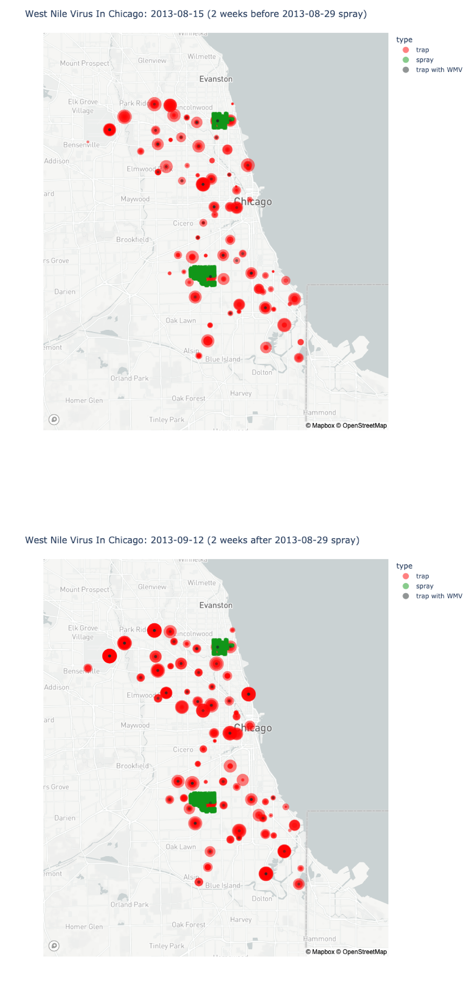

In [41]:
fig = plt.figure()

ax1 = fig.add_subplot(2,1,1)
ax2 = fig.add_subplot(2,1,2)

img1 = mpimg.imread(f'../images/spray_before_{image_date}.png')
ax1.imshow(img1)
ax1.axis('off')

img2 = mpimg.imread(f'../images/spray_after_{image_date}.png')
ax2.imshow(img2)
ax2.axis('off')

plt.subplots_adjust(wspace=0, hspace=0)
fig.set_figheight(90)
fig.set_figwidth(40)

# 10. Insecticide spray on 05-09-2013

## 10.1. 2 Weeks before 05-09-2013

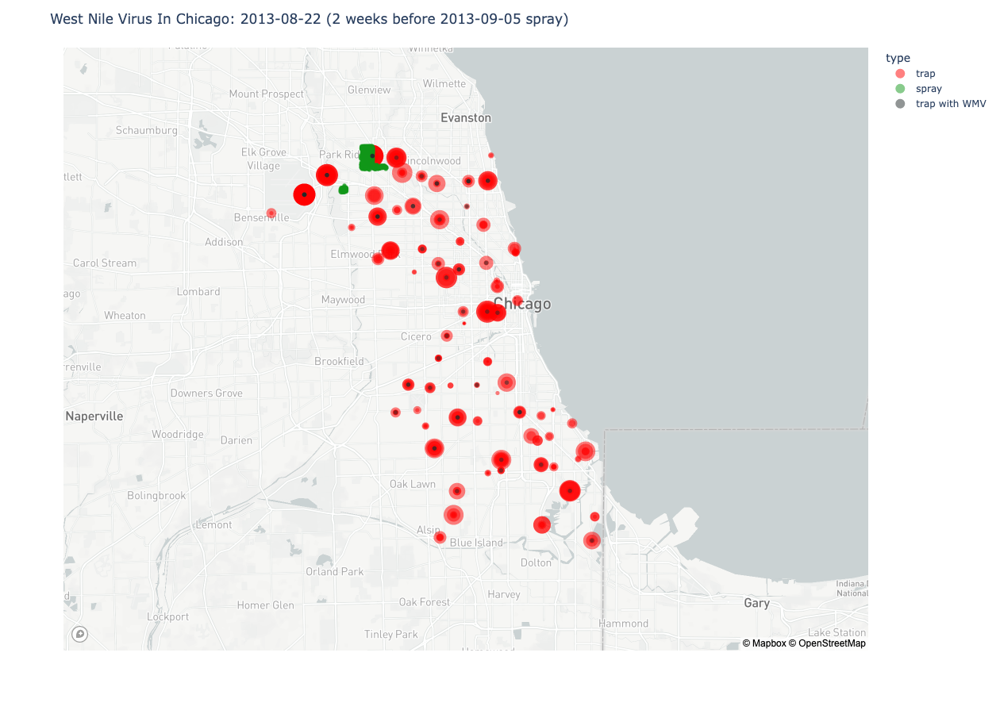

In [42]:
spray_date = pd.Timestamp(2013, 9, 5)

period_before = (spray_date - datetime.timedelta(weeks=2))
period_after= (spray_date + datetime.timedelta(weeks=2))





px.set_mapbox_access_token(MAPBOX_TOKEN)


fig = px.scatter_mapbox(merged[(merged.type=='trap') & (merged['date_datetime'] >= period_before) & (merged['date_datetime'] < spray_date)],
                        lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                        size='nummosquitos',
                        color_discrete_sequence=['red'],
                        opacity = 0.5,
                       zoom = 9.5) # size_max=15, 

fig2 = px.scatter_mapbox(merged[(merged.type=='spray') & (merged.date_datetime == spray_date)], lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                         color_discrete_sequence=['#109618'],
                        size_max=1, 
                         opacity=0.5,
                         zoom = 9.5)

fig3 = px.scatter_mapbox(merged_wmv_traps[(merged_wmv_traps.date_datetime >= period_before) & (merged_wmv_traps.date_datetime < spray_date)],
                         lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                         color_discrete_sequence=['#222A2A'],
                        size_max=1, 
                         opacity=0.5,
                         zoom =9.5)

fig.add_trace(fig2.data[0])
fig.add_trace(fig3.data[0])

image_date = merged[(merged.date_datetime == spray_date)].date.iloc[0]
period_before = period_before.date()

fig.update_layout(title = f'West Nile Virus In Chicago: {period_before} (2 weeks before {image_date} spray)',
                  mapbox_center={"lat": 41.834, "lon": -87.693}, # center map to a particular point
                  autosize=True,
                  width=900,
                  height=900,)

fig.show()
fig.write_image(f'../images/spray_before_{image_date}.png')

## 10.2. 2 Weeks After 05-09-2013

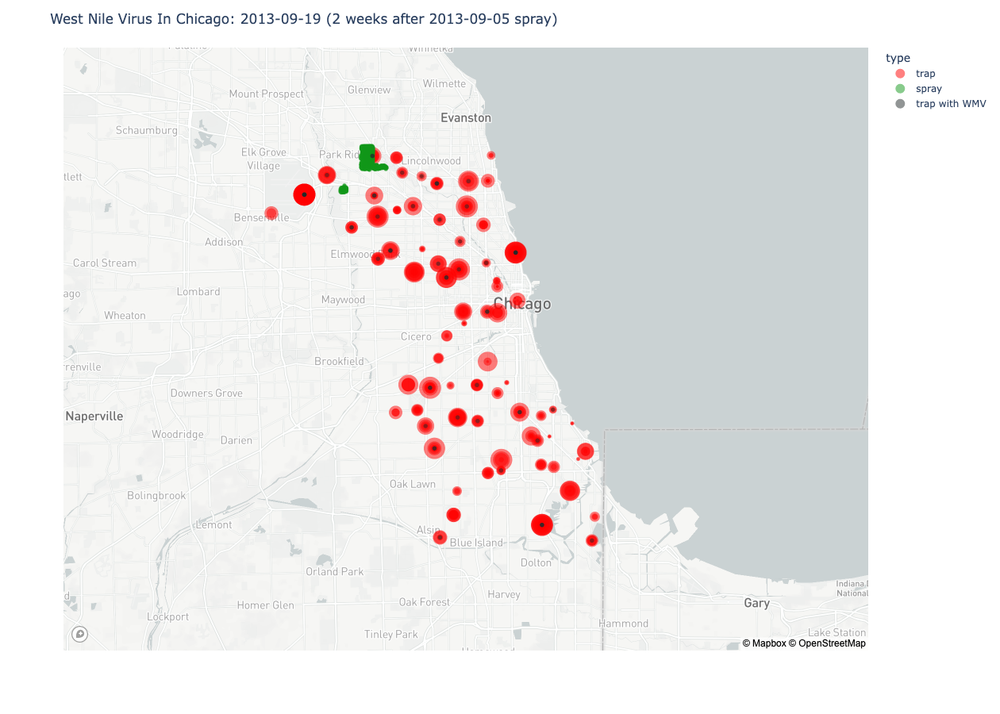

In [43]:
spray_date = pd.Timestamp(2013, 9, 5)

period_before = (spray_date - datetime.timedelta(weeks=2))
period_after= (spray_date + datetime.timedelta(weeks=2))





px.set_mapbox_access_token(MAPBOX_TOKEN)


fig = px.scatter_mapbox(merged[(merged.type=='trap') & (merged['date_datetime'] >= spray_date) & (merged['date_datetime'] <= period_after)],
                        lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                        size='nummosquitos',
                        color_discrete_sequence=['red'],
                        opacity = 0.5,
                       zoom = 9.5) # size_max=15, 

fig2 = px.scatter_mapbox(merged[(merged.type=='spray') & (merged.date_datetime == spray_date)], lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                         color_discrete_sequence=['#109618'],
                        size_max=1, 
                         opacity=0.5,
                         zoom = 9.5)

fig3 = px.scatter_mapbox(merged_wmv_traps[(merged_wmv_traps.date_datetime >= spray_date) & (merged_wmv_traps.date_datetime <= period_after)],
                         lat = 'lat', lon  = 'long', 
                        color='type', # coloring the points based on the date clumn
                         color_discrete_sequence=['#222A2A'],
                        size_max=1, 
                         opacity=0.5,
                         zoom =9.5)

fig.add_trace(fig2.data[0])
fig.add_trace(fig3.data[0])

image_date = merged[(merged.date_datetime == spray_date)].date.iloc[0]
period_after = period_after.date()

fig.update_layout(title = f'West Nile Virus In Chicago: {period_after} (2 weeks after {image_date} spray)',
                  mapbox_center={"lat": 41.834, "lon": -87.693}, # center map to a particular point
                  autosize=True,
                  width=900,
                  height=900,)

fig.show()
fig.write_image(f'../images/spray_after_{image_date}.png')

## 10.3. Side by side comparison of affected areas before and after 05-09-2013

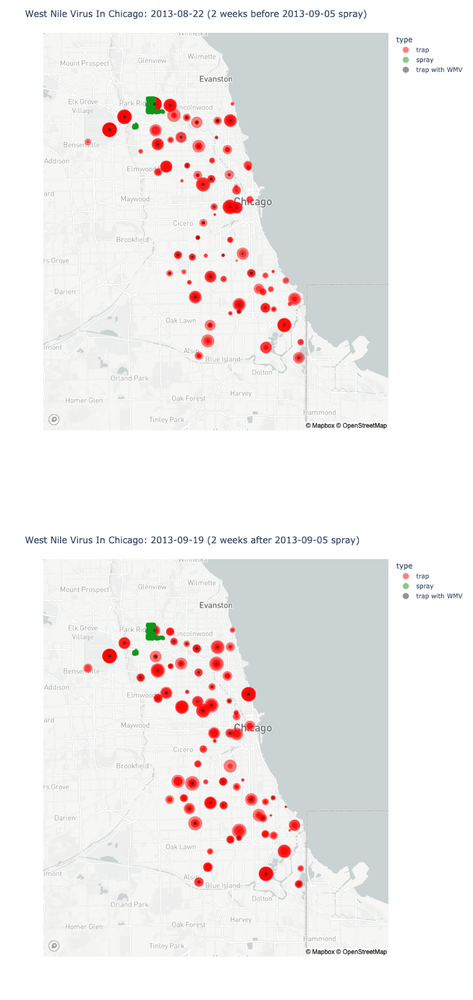

In [44]:
fig = plt.figure()

ax1 = fig.add_subplot(2,1,1)
ax2 = fig.add_subplot(2,1,2)

img1 = mpimg.imread(f'../images/spray_before_{image_date}.png')
ax1.imshow(img1)
ax1.axis('off')

img2 = mpimg.imread(f'../images/spray_after_{image_date}.png')
ax2.imshow(img2)
ax2.axis('off')

plt.subplots_adjust(wspace=0, hspace=0)
fig.set_figheight(90)
fig.set_figwidth(40)

# Findings

## 1. Spraying coverage is poor

The plots above demonstrate that even though there is a reduction in the number of mosquitoes in the immediate vincity of the sprayed areas, it is clear that large areas of Chicago continue to be hot spots.

## 2. Spraying is ineffective

While there is reduction in the number of mosquitoes where insecticides is sprayed, spraying alone appears to be ineffective given the continued existence of hot spots near the sprayed areas. 